# Statistics on Swiss Met Net stations

We begin by importing some general and local modules.

## 1. Preparing data

### 1.a. Useful modules

In [2]:
import os, sys
dev_path = os.path.abspath('')
src_path = os.path.join(dev_path, "..", 'src')
sys.path.append(src_path)

In [3]:
import warnings
warnings.filterwarnings('ignore')

In [4]:
import stormTracks.STtoolbox as sttb
import swissMetNet.SMNtoolbox as smntb
import pwOutputs.PWtoolbox as pwtb
import linReg.Statistics as lrstat

In [5]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
import xarray as xr
import seaborn as sns
import pandas as pd
import geopandas as gpd
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import cartopy.io.img_tiles as cimgt
import pickle

from sklearn.cluster import KMeans, SpectralClustering, AffinityPropagation, AgglomerativeClustering
from sklearn import metrics

sns.set_theme()

### 1.b. Function definitions

In [24]:
def loadAffinities(**kwargs):

    fromFile = kwargs.pop("fromFile", None)
    if not (fromFile is None):
        try:
            with open(fromFile, "rb") as f:
                return pickle.load(f)
        except:
            return loadAffinities(**kwargs)
    else:
        data = kwargs.get("data")
        nb_of_stations = len(data.station.values)
        return np.array([[xr.corr(data.isel(station=i), data.isel(station=j), dim = "time").values for i in range(nb_of_stations)] for j in range(nb_of_stations)])

In [8]:
def KMeansStationClustering(data, statistics, **kwargs):
    """
    Cluster data based on a set of statistics provided as functions with K-Means algorithm.
    
    Parameters
    ----------
    data : xarray.Dataset
        The data to cluster.
    statistics : list
        A list of (function_name, function) to apply to the data.
    
    Returns
    """
    measures = [stat[1](data) for stat in statistics]
    stations = data.station.values
    result = xr.Dataset(
        data_vars = dict([ (statistics[i][0], measures[i] ) for i in range(len(statistics)) ]),
        coords = {"station":data.station,
                  "longitude":data.longitude,
                  "latitude":data.latitude
                  }
    )
    result = result.dropna(dim = "station", how = "any")
    X = np.array([result[stat[0]] for stat in statistics]).T
    kmeans = KMeans(n_clusters = kwargs.get("n_clusters", 2), n_init = kwargs.get("n_init", 10)).fit(X)
    
    result["label"] = xr.DataArray(kmeans.labels_, coords = {"station":result.station}, dims = ["station"])
    return result, metrics.silhouette_score(X, kmeans.labels_, metric='euclidean')

In [9]:
def SpectralStationClustering(data, **kwargs):
    """
    Cluster data based on correlation between station, aggregated over time, with Spectral Clustering algorithm.
    """
    stations = data.station.values
    nb_of_stations = len(stations)
    if "affinities" in kwargs.keys():
        affinities = kwargs.get("affinities")
    else:
        affinities = np.array([[xr.corr(data.isel(station=i), data.isel(station=j), dim = "time").values for i in range(nb_of_stations)] for j in range(nb_of_stations)])
    affinities = np.abs(affinities) if kwargs.get("method", "abs") == "abs" else affinities
    nans = np.isnan(np.diag(affinities))
    nansmatrix = nans.reshape((-1,1))@nans.reshape((1,-1))
    affinities = affinities[~nans][:,~nans]
    np.nan_to_num(affinities, copy = False, nan=0.)
    result = xr.Dataset(
        data_vars = {"affinity":(["station", "station"], affinities)},
        coords = {"station":("station",data.station.values[~nans]),
                  "longitude":("station",data.longitude.values[~nans]),
                  "latitude":("station",data.latitude.values[~nans])
                  }
    )
    clustering = SpectralClustering(n_clusters = kwargs.get("n_clusters", 2), n_init = kwargs.get("n_init", 10), assign_labels='discretize', affinity = 'precomputed').fit(affinities)
    result["label"] = xr.DataArray(clustering.labels_, coords = {"station":result.station}, dims = ["station"])
    distances = np.clip(-np.log(affinities), a_min = 0, a_max = 1e8)
    np.nan_to_num(distances, copy = False, nan=1e8)
    return result, metrics.silhouette_score(distances, clustering.labels_, metric='precomputed')

In [10]:
def AgglomerativeStationClustering(data, **kwargs):
    """
    Cluster data based on correlation between station, aggregated over time, with Spectral Clustering algorithm.
    """
    stations = data.station.values
    nb_of_stations = len(stations)
    if "affinities" in kwargs.keys():
        affinities = kwargs.get("affinities")
    else:
        affinities = np.array([[xr.corr(data.isel(station=i), data.isel(station=j), dim = "time").values for i in range(nb_of_stations)] for j in range(nb_of_stations)])
    affinities = np.abs(affinities) if kwargs.get("method", "abs") == "abs" else affinities
    nans = np.isnan(np.diag(affinities))
    nansmatrix = nans.reshape((-1,1))@nans.reshape((1,-1))
    affinities = affinities[~nans][:,~nans]
    np.nan_to_num(affinities, copy = False, nan=0.)
    result = xr.Dataset(
        data_vars = {"affinity":(["station", "station"], affinities)},
        coords = {"station":("station",data.station.values[~nans]),
                  "longitude":("station",data.longitude.values[~nans]),
                  "latitude":("station",data.latitude.values[~nans])
                  }
    )
    clustering = AgglomerativeClustering(n_clusters = kwargs.get("n_clusters", 2), metric = 'precomputed', linkage = "average").fit(affinities)
    result["label"] = xr.DataArray(clustering.labels_, coords = {"station":result.station}, dims = ["station"])
    return result, metrics.silhouette_score(affinities, clustering.labels_, metric='precomputed')

In [11]:
def AffinityPropagationClustering(data, **kwargs):
    """
    Cluster data based on correlation between station, aggregated over time, with Spectral Clustering algorithm.
    """
    stations = data.station.values
    nb_of_stations = len(stations)
    if "affinities" in kwargs.keys():
        affinities = kwargs.get("affinities")
    else:
        affinities = np.array([[xr.corr(data.isel(station=i), data.isel(station=j), dim = "time").values for i in range(nb_of_stations)] for j in range(nb_of_stations)])
    affinities = np.abs(affinities) if kwargs.get("method", "abs") == "abs" else affinities
    nans = np.isnan(np.diag(affinities))
    nansmatrix = nans.reshape((-1,1))@nans.reshape((1,-1))
    affinities = affinities[~nans][:,~nans]
    np.nan_to_num(affinities, copy = False, nan=0.)
    result = xr.Dataset(
        data_vars = {"affinity":(["station", "station"], affinities)},
        coords = {"station":("station",data.station.values[~nans]),
                  "longitude":("station",data.longitude.values[~nans]),
                  "latitude":("station",data.latitude.values[~nans])
                  }
    )
    clustering = AffinityPropagation(affinity = 'precomputed').fit(affinities)
    result["label"] = xr.DataArray(clustering.labels_, coords = {"station":result.station}, dims = ["station"])
    return result, metrics.silhouette_score(affinities, clustering.labels_, metric='precomputed')

In [12]:
def plotStations(longitude, latitude, labels = None, **kwargs):
    
    google_tiles = cimgt.GoogleTiles(style='satellite')
    n_clusters = kwargs.get("clusters", None)
    if isinstance(n_clusters, list):
        silh = kwargs.get("silhouette_score")
        title = kwargs.get("title", None)
        fig = plt.figure(figsize = ((len(n_clusters)//3 + 1)*5, 15))
        fig.tight_layout()
        fig.suptitle("SwissMetNet stations" if title is None else title, fontsize = 30)
        gs = GridSpec(nrows = len(n_clusters)//3 + 1, ncols = 3)
        for i in range(len(n_clusters)):
            ax = fig.add_subplot(gs[i//3, i%3], projection=google_tiles.crs)
            ax.add_feature(cfeature.BORDERS)
            ax.set_extent([5.8, 10.5, 45.8, 47.8], crs=ccrs.PlateCarree())
            ax.add_image(google_tiles, 9)

            color = labels[i]
            ax.scatter(longitude, latitude, transform=ccrs.PlateCarree(), marker = kwargs.get("marker", "X"), c = color, zorder = 3, cmap = 'inferno')
            ax.gridlines(draw_labels=True, auto_inline=True)
            ax.xaxis.set_label_position('top')
            # add a box around the following annotation
            ax.legend([f"n_clusters = {n_clusters[i]}"]).set_zorder(10)
            
        
        ax = fig.add_subplot(gs[-1, :])
        ax.plot(n_clusters, silh, 'rx-')
        ax.set_xlabel("n_clusters")
        ax.set_ylabel("Silhouette score")

        if kwargs.get("toFile", None):
            fig.savefig(kwargs.get("toFile", None), bbox_inches='tight')
        if kwargs.get("show", False):
            plt.show()
            plt.close()
        
    else:
        fig, ax = plt.subplots(subplot_kw={'projection': google_tiles.crs})
        ax.set_extent([5.8, 10.5, 45.8, 47.8], crs=ccrs.PlateCarree())
        ax.add_feature(cfeature.BORDERS)
        ax.add_image(google_tiles, 9)

        color = 'darkred' if labels is None else labels
        ax.scatter(longitude, latitude, transform=ccrs.PlateCarree(), marker = kwargs.get("markers", "X"), c = color, zorder = 3, cmap = 'inferno')
        ax.gridlines(draw_labels=True, auto_inline=True)
        ax.xaxis.set_label_position('top')
        title = kwargs.get("title", None)
        ax.set_title("SwissMetNet stations" if title is None else title)

        if kwargs.get("toFile", None):
            fig.savefig(kwargs.get("toFile", None), bbox_inches='tight')
        if kwargs.get("show", False):
            plt.show()
            plt.close()
    return fig, ax

### 1.c. Getting data

We then import the available data on Swiss Met Net, previously produced with SMNtoolbox, and concatenate it over time. We use `DataArray.mean(dim = "time)` as the quickest manner to make `longitude` and `latitude` only station-dependant.

In [13]:
data2016 = lrstat.loadData(fromFile = "/work/FAC/FGSE/IDYST/tbeucler/downscaling/alecler1/treated_data/SwissMetNet/2016/SMN_Pangu_2016.nc")
data2017 = lrstat.loadData(fromFile = "/work/FAC/FGSE/IDYST/tbeucler/downscaling/alecler1/treated_data/SwissMetNet/2017/SMN_Pangu_2017.nc")
data2018 = lrstat.loadData(fromFile = "/work/FAC/FGSE/IDYST/tbeucler/downscaling/alecler1/treated_data/SwissMetNet/2018/SMN_Pangu_2018.nc")


Loading data from /work/FAC/FGSE/IDYST/tbeucler/downscaling/alecler1/treated_data/SwissMetNet/2016/SMN_Pangu_2016.nc
Loading data from /work/FAC/FGSE/IDYST/tbeucler/downscaling/alecler1/treated_data/SwissMetNet/2017/SMN_Pangu_2017.nc
Loading data from /work/FAC/FGSE/IDYST/tbeucler/downscaling/alecler1/treated_data/SwissMetNet/2018/SMN_Pangu_2018.nc


In [14]:
wg = xr.concat([data2016.wind_speed_of_gust, data2017.wind_speed_of_gust, data2018.wind_speed_of_gust], dim='time')
wg["latitude"] = wg["latitude"].mean(dim="time")
wg["longitude"] = wg["longitude"].mean(dim="time")

precip = xr.concat([data2016.precipitation_amount, data2017.precipitation_amount, data2018.precipitation_amount], dim='time')
precip["latitude"] = precip["latitude"].mean(dim="time")
precip["longitude"] = precip["longitude"].mean(dim="time")

We show here a brief view of the different stations available over Switzerland:

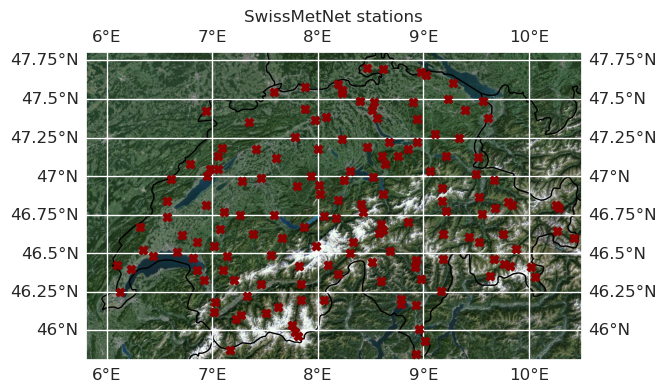

In [20]:
longitude, latitude = wg.longitude, wg.latitude

plotStations(longitude, latitude, toFile = "../../plots/SwissMetNet/SwissMetNet_stations.png", show = True);

## 2. Statistics on the stations

Let's begin with some statistics on different stations, and try to find relevant distributions for the wind gust and other variables.

### 2.a. General climatology of wind gust per station

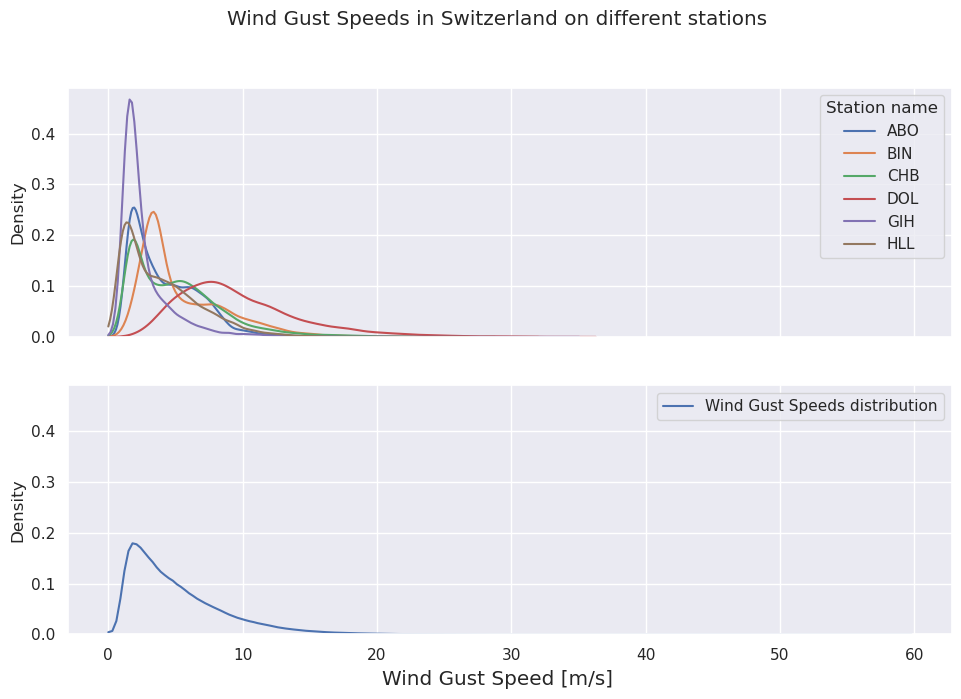

In [8]:
fig, ax = plt.subplots(nrows = 2, ncols = 1, figsize = (10,7), sharex = True, sharey = True)

fig.suptitle("Wind Gust Speeds in Switzerland on different stations")
fig.tight_layout(pad = 2, h_pad=2, w_pad=2)

sns.kdeplot(wg.values.flatten(), ax = ax[1], label = "Wind Gust Speeds distribution", clip = (0.,60.))
ax[1].legend()

for i in range(3):
    for j in range(2):
        sns.kdeplot(wg.isel(station=i*30+j*15), ax = ax[0], label = wg.isel(station=i*30+j*15).station.values, clip = (0.,60.))
fig.supxlabel("Wind Gust Speed [m/s]")
ax[0].legend(title = "Station name")
        
plt.show();

### 2.b. Monthly climatology for different stations

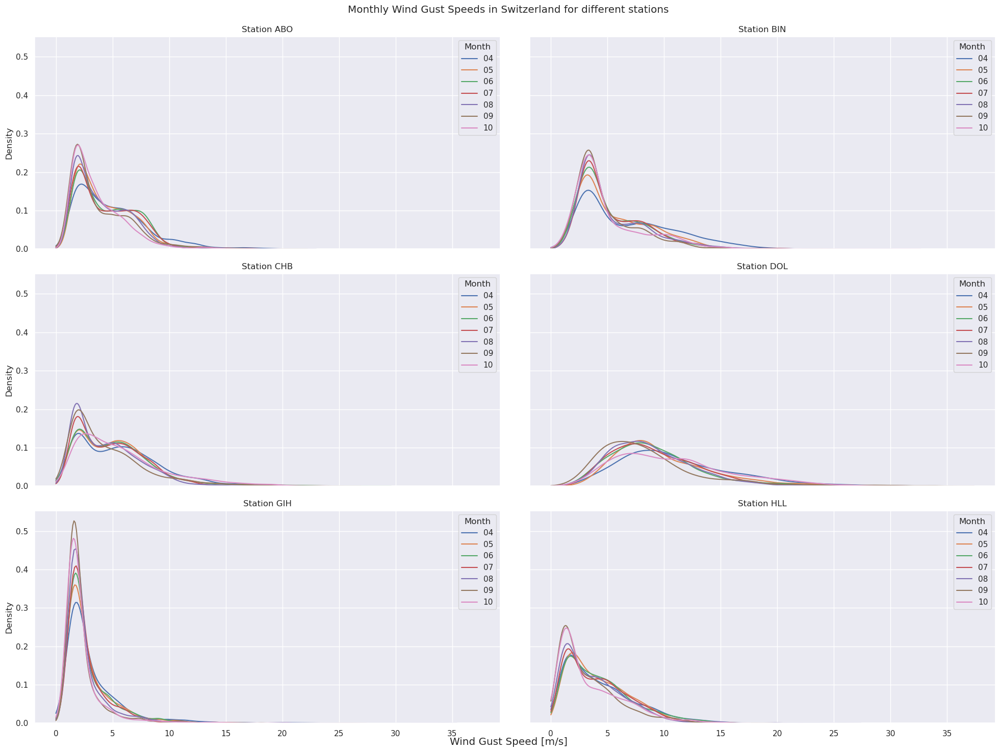

In [9]:
fig, ax = plt.subplots(nrows = 3, ncols = 2, figsize = (20,15), sharex = True, sharey = True)

fig.suptitle("Monthly Wind Gust Speeds in Switzerland for different stations")
fig.tight_layout(pad = 2, h_pad=2, w_pad=2)

for i in range(3):
    for j in range(2):
        for month in range(4,11):
            sns.kdeplot(wg.where(wg.time.dt.month == month).isel(station=i*30+j*15), ax = ax[i,j], clip = (0.,60.), label = f"{month:02d}")
        ax[i,j].set_title(f"Station {wg.isel(station=i*30+j*15).station.values}")
        ax[i,j].legend(title = "Month")
        
fig.supxlabel("Wind Gust Speed [m/s]")
        
plt.show();

### 2.c. Correlation between stations

In [25]:
affwg = loadAffinities(data = wg, fromFile = "/work/FAC/FGSE/IDYST/tbeucler/downscaling/alecler1/treated_data/SwissMetNet/wgAffinity.pkl")
affprecip = loadAffinities(data = precip, fromFile = "/work/FAC/FGSE/IDYST/tbeucler/downscaling/alecler1/treated_data/SwissMetNet/precipAffinity.pkl")

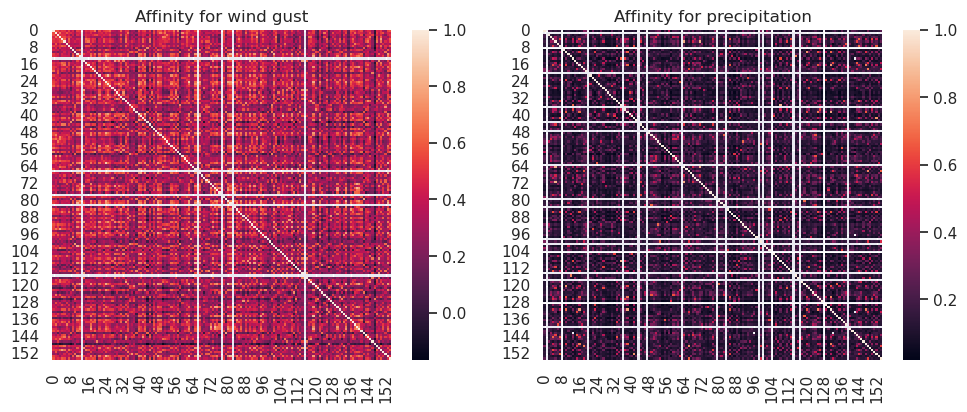

In [30]:
fig, ax = plt.subplots(nrows = 1, ncols = 2, figsize = (10,4))
fig.tight_layout()

sns.heatmap(affwg, ax = ax[0])
ax[0].set_title("Affinity for wind gust")

sns.heatmap(affprecip, ax = ax[1])
ax[1].set_title("Affinity for precipitation")

plt.show()

In [15]:
with open("/work/FAC/FGSE/IDYST/tbeucler/downscaling/alecler1/treated_data/SwissMetNet/wgAffinity.pkl", "wb") as f:
    pickle.dump(affwg, f)

with open("/work/FAC/FGSE/IDYST/tbeucler/downscaling/alecler1/treated_data/SwissMetNet/precipAffinity.pkl", "wb") as f:
    pickle.dump(affprecip, f)

Interestingly, we observe that the heatmap for correlation for precipitation looks sparser than the one for wind gust : this shows a shorter correlation characteristc length for precipitation than for wind gust, which looks coherent: precipitation systems tend to be more localised than wind systems.

### 2.d. Wind gust and precip correlations to other parameters

To finish this preanalysis, let's take a look at the observed dependance of measured wind gust and precip to other parameters - when there is a storm and when there is not. We will use the inverse distance weighting to ponder the importance of storms on the observations.

Let's begin with wind gust:

In [ ]:
data = xr.concat([data2016, data2017, data2018], dim='time')


### Test cells

In [66]:
# Test cell
nb_of_stations = wg.station.size
affinities = np.array([[xr.corr(wg.isel(station=i), wg.isel(station=j), dim = "time").values for i in range(nb_of_stations)] for j in range(nb_of_stations)])
affinities

/work/FAC/FGSE/IDYST/tbeucler/downscaling/alecler1/alpth/lib/python3.10/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/work/FAC/FGSE/IDYST/tbeucler/downscaling/alecler1/alpth/lib/python3.10/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/work/FAC/FGSE/IDYST/tbeucler/downscaling/alecler1/alpth/lib/python3.10/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/work/FAC/FGSE/IDYST/tbeucler/downscaling/alecler1/alpth/lib/python3.10/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/work/FAC/FGSE/IDYST/tbeucler/downscaling/alecler1/alpth/lib/python3.10/site

array([[1.        , 0.56499484, 0.56891716, ..., 0.25570608, 0.53612798,
        0.58883517],
       [0.56499484, 1.        , 0.46594653, ..., 0.34276168, 0.46140997,
        0.43856535],
       [0.56891716, 0.46594653, 1.        , ..., 0.19822456, 0.42816321,
        0.50737237],
       ...,
       [0.25570608, 0.34276168, 0.19822456, ..., 1.        , 0.2276698 ,
        0.21102393],
       [0.53612798, 0.46140997, 0.42816321, ..., 0.2276698 , 1.        ,
        0.47325454],
       [0.58883517, 0.43856535, 0.50737237, ..., 0.21102393, 0.47325454,
        1.        ]])

In [101]:
nans = np.isnan(np.diag(affinities))
affinities2 = affinities[~nans][:,~nans]
longitude = wg.longitude.values[~nans]
latitude = wg.latitude.values[~nans]

In [97]:
clusteringabs = SpectralClustering(n_clusters=2, assign_labels='discretize', affinity = 'precomputed').fit(np.abs(affinities2))
clusteringsquare = SpectralClustering(n_clusters=2, assign_labels='discretize', affinity = 'precomputed').fit(affinities2**2)

In [104]:
test = xr.Dataset(
    data_vars = {"affinity":(["station", "station"], affinities)},
    coords = {"station":wg.station,
                "longitude":wg.longitude,
                "latitude":wg.latitude
                }
)

/work/FAC/FGSE/IDYST/tbeucler/downscaling/alecler1/alpth/lib/python3.10/site-packages/xarray/namedarray/core.py:496: UserWarning: Duplicate dimension names present: dimensions {'station'} appear more than once in dims=('station', 'station'). We do not yet support duplicate dimension names, but we do allow initial construction of the object. We recommend you rename the dims immediately to become distinct, as most xarray functionality is likely to fail silently if you do not. To rename the dimensions you will need to set the ``.dims`` attribute of each variable, ``e.g. var.dims=('x0', 'x1')``.
  warnings.warn(


In [107]:
test.dropna(dim = "station", how="any")

/work/FAC/FGSE/IDYST/tbeucler/downscaling/alecler1/alpth/lib/python3.10/site-packages/xarray/namedarray/core.py:496: UserWarning: Duplicate dimension names present: dimensions {'station'} appear more than once in dims=('station', 'station'). We do not yet support duplicate dimension names, but we do allow initial construction of the object. We recommend you rename the dims immediately to become distinct, as most xarray functionality is likely to fail silently if you do not. To rename the dimensions you will need to set the ``.dims`` attribute of each variable, ``e.g. var.dims=('x0', 'x1')``.
  warnings.warn(


ValueError: non-broadcastable output operand with shape (155,) doesn't match the broadcast shape (155,155)

UnboundLocalError: local variable 'title' referenced before assignment

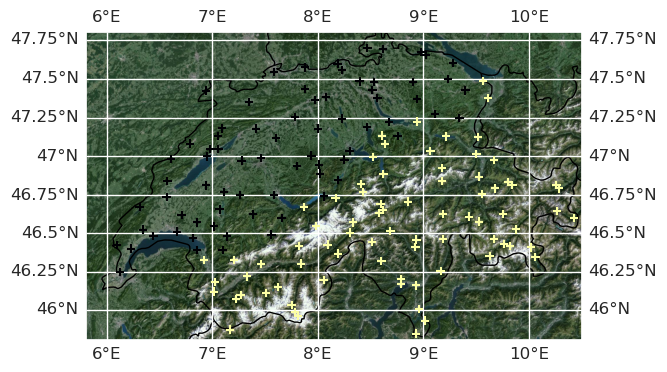

In [102]:
smntb.plotStations(longitude, latitude, clusteringabs.labels_)

## 3. Clustering stations

### 3.a. K-Means clustering based on projection of station wind gust distribution in lower dimension vectorial spaces

In [16]:
silh = {}

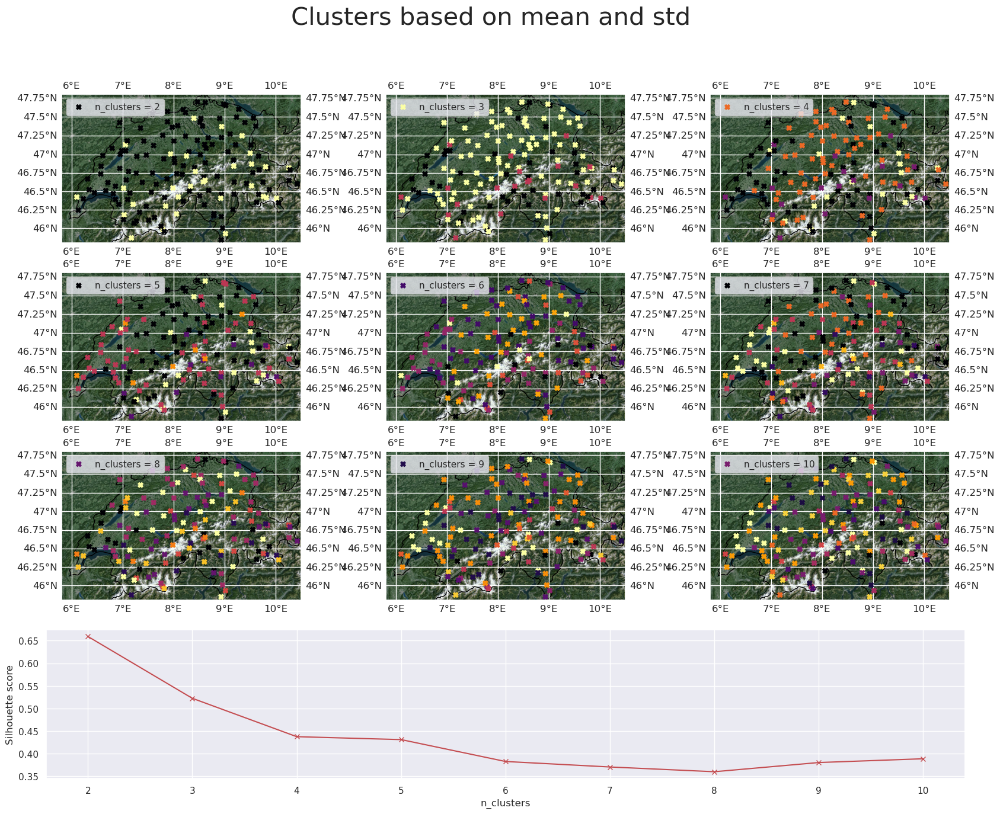

In [45]:
statistics= [
    ("mean", lambda x : x.mean(dim = "time")),
    ("std", lambda x : x.std(dim = "time"))
    ]

sil = [0.]*9
n_clusters = list(np.arange(2,11))
labels = [None]*9


for i in range(3):
    for j in range(3):
        result, sil[i*3+j] = KMeansStationClustering(wg, statistics, n_clusters = 2 +i*3 + j)
        labels[i*3+j] = result.label

title = "mean and std"
smntb.plotStations(result.longitude, result.latitude, labels = labels, title = f"Clusters based on " + title, clusters = n_clusters, silhouette_score = sil)

silh[title] = sil
print();

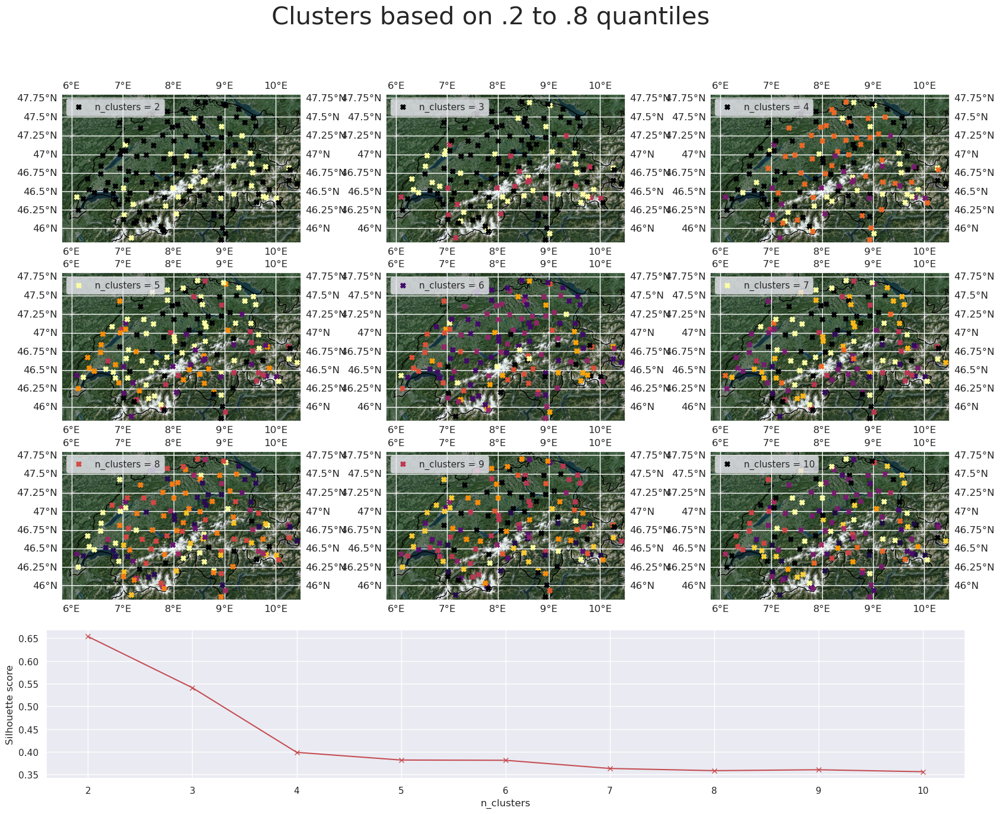

In [46]:
statistics = [
    ("quantile2", lambda x : x.quantile(0.2, dim = "time").drop_vars("quantile")),
    ("quantile4", lambda x : x.quantile(0.4, dim = "time").drop_vars("quantile")),
    ("quantile6", lambda x : x.quantile(0.6, dim = "time").drop_vars("quantile")),
    ("quantile8", lambda x : x.quantile(0.8, dim = "time").drop_vars("quantile"))
    ]

sil = [0.]*9
n_clusters = list(np.arange(2,11))
labels = [None]*9


for i in range(3):
    for j in range(3):
        result, sil[i*3+j] = KMeansStationClustering(wg, statistics, n_clusters = 2 +i*3 + j)
        labels[i*3+j] = result.label

title = ".2 to .8 quantiles"
smntb.plotStations(result.longitude, result.latitude, labels = labels, title = f"Clusters based on " + title, clusters = n_clusters, silhouette_score = sil)

silh[title] = sil
print();

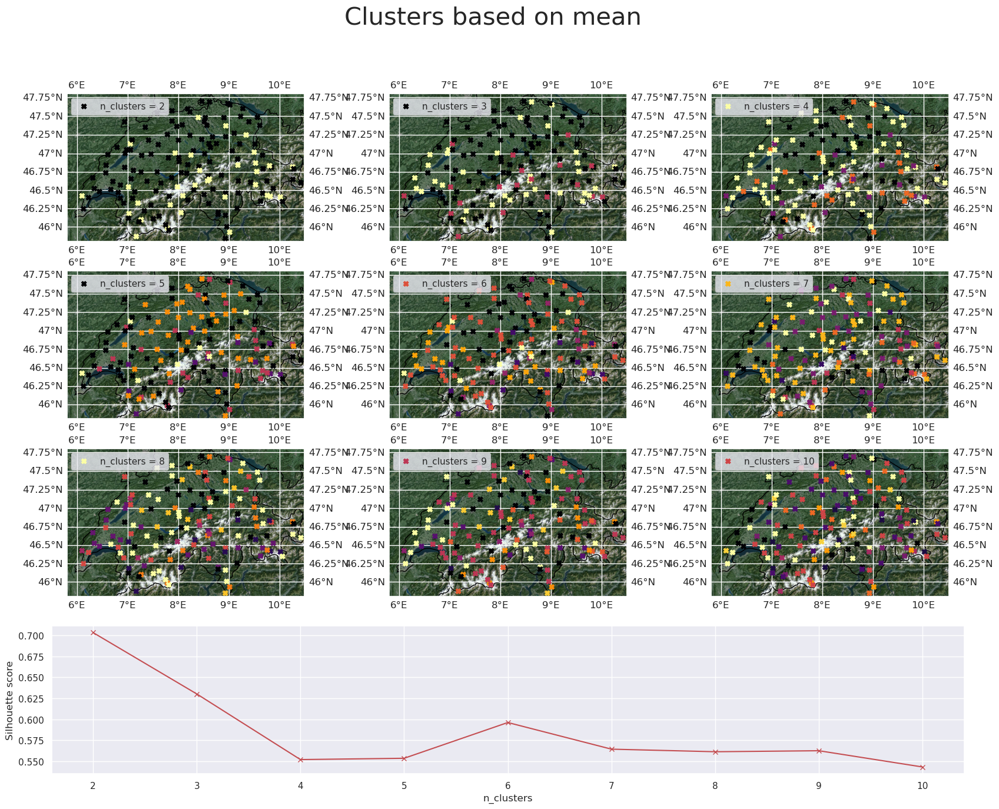

In [47]:
statistics= [
    ("mean", lambda x : x.mean(dim = "time"))
    ]

sil = [0.]*9
n_clusters = list(np.arange(2,11))
labels = [None]*9


for i in range(3):
    for j in range(3):
        result, sil[i*3+j] = KMeansStationClustering(wg, statistics, n_clusters = 2 +i*3 + j)
        labels[i*3+j] = result.label

title = "mean"
smntb.plotStations(result.longitude, result.latitude, labels = labels, title = f"Clusters based on " + title, clusters = n_clusters, silhouette_score = sil)

silh[title] = sil
print();

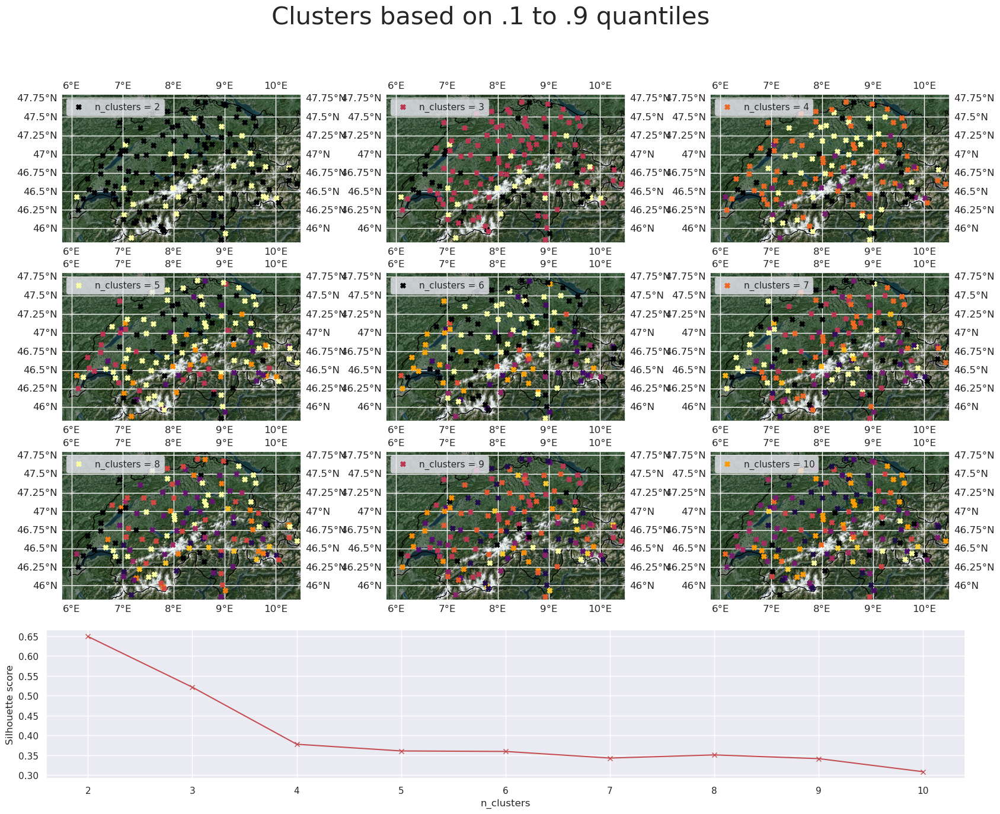

In [48]:

statistics = [
    ("quantile1", lambda x : x.quantile(0.1, dim = "time").drop_vars("quantile")),
    ("quantile2", lambda x : x.quantile(0.2, dim = "time").drop_vars("quantile")),
    ("quantile3", lambda x : x.quantile(0.3, dim = "time").drop_vars("quantile")),
    ("quantile4", lambda x : x.quantile(0.4, dim = "time").drop_vars("quantile")),
    ("quantile5", lambda x : x.quantile(0.5, dim = "time").drop_vars("quantile")),
    ("quantile6", lambda x : x.quantile(0.6, dim = "time").drop_vars("quantile")),
    ("quantile7", lambda x : x.quantile(0.7, dim = "time").drop_vars("quantile")),
    ("quantile8", lambda x : x.quantile(0.8, dim = "time").drop_vars("quantile")),
    ("quantile9", lambda x : x.quantile(0.9, dim = "time").drop_vars("quantile"))
    ]

sil = [0.]*9
n_clusters = list(np.arange(2,11))
labels = [None]*9


for i in range(3):
    for j in range(3):
        result, sil[i*3+j] = KMeansStationClustering(wg, statistics, n_clusters = 2 +i*3 + j)
        labels[i*3+j] = result.label

title = ".1 to .9 quantiles"
smntb.plotStations(result.longitude, result.latitude, labels = labels, title = f"Clusters based on " + title, clusters = n_clusters, silhouette_score = sil)

silh[title] = sil
print();

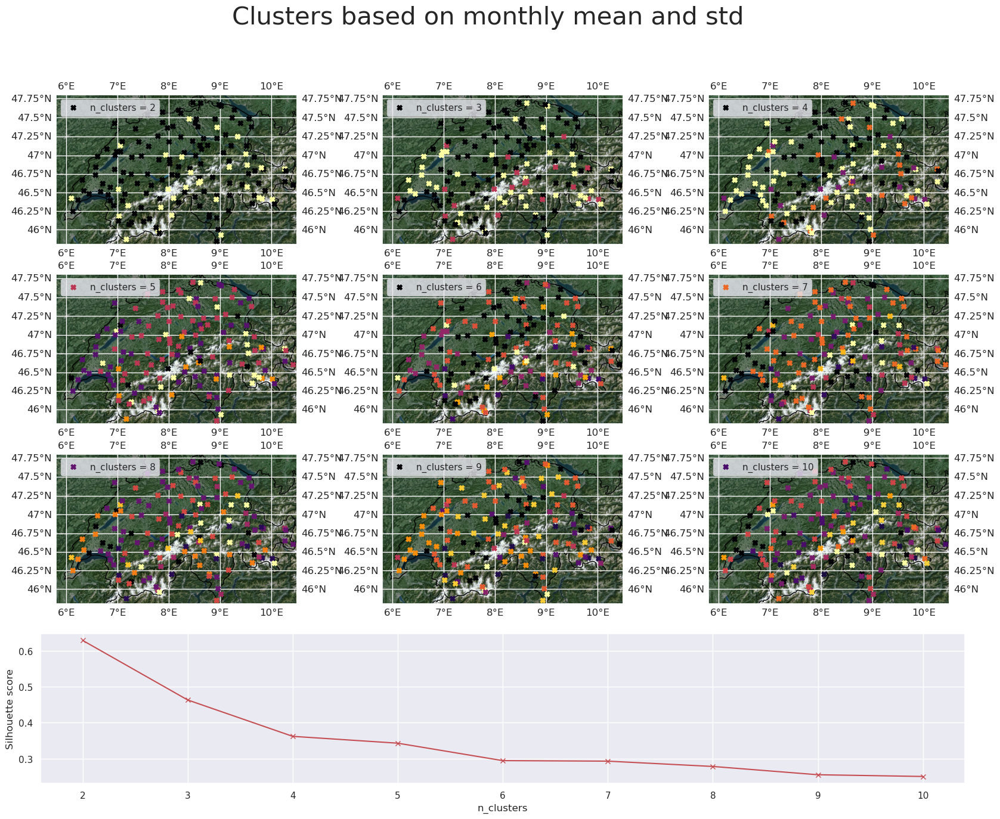

In [49]:

statistics = [
    ("mean4", lambda x : x.where(x.time.dt.month == 4).mean(dim = "time")),
    ("mean5", lambda x : x.where(x.time.dt.month == 5).mean(dim = "time")),
    ("mean6", lambda x : x.where(x.time.dt.month == 6).mean(dim = "time")),
    ("mean7", lambda x : x.where(x.time.dt.month == 7).mean(dim = "time")),
    ("mean8", lambda x : x.where(x.time.dt.month == 8).mean(dim = "time")),
    ("mean9", lambda x : x.where(x.time.dt.month == 9).mean(dim = "time")),
    ("mean10", lambda x : x.where(x.time.dt.month == 10).mean(dim = "time")),
    ("std4", lambda x : x.where(x.time.dt.month == 4).std(dim = "time")),
    ("std5", lambda x : x.where(x.time.dt.month == 5).std(dim = "time")),
    ("std6", lambda x : x.where(x.time.dt.month == 6).std(dim = "time")),
    ("std7", lambda x : x.where(x.time.dt.month == 7).std(dim = "time")),
    ("std8", lambda x : x.where(x.time.dt.month == 8).std(dim = "time")),
    ("std9", lambda x : x.where(x.time.dt.month == 9).std(dim = "time")),
    ("std10", lambda x : x.where(x.time.dt.month == 10).std(dim = "time"))
    ]

sil = [0.]*9
n_clusters = list(np.arange(2,11))
labels = [None]*9


for i in range(3):
    for j in range(3):
        result, sil[i*3+j] = KMeansStationClustering(wg, statistics, n_clusters = 2 +i*3 + j)
        labels[i*3+j] = result.label

title = "monthly mean and std"
smntb.plotStations(result.longitude, result.latitude, labels = labels, title = f"Clusters based on " + title, clusters = n_clusters, silhouette_score = sil)

silh[title] = sil
print();


<urlopen error [SSL: UNEXPECTED_EOF_WHILE_READING] EOF occurred in violation of protocol (_ssl.c:1007)>


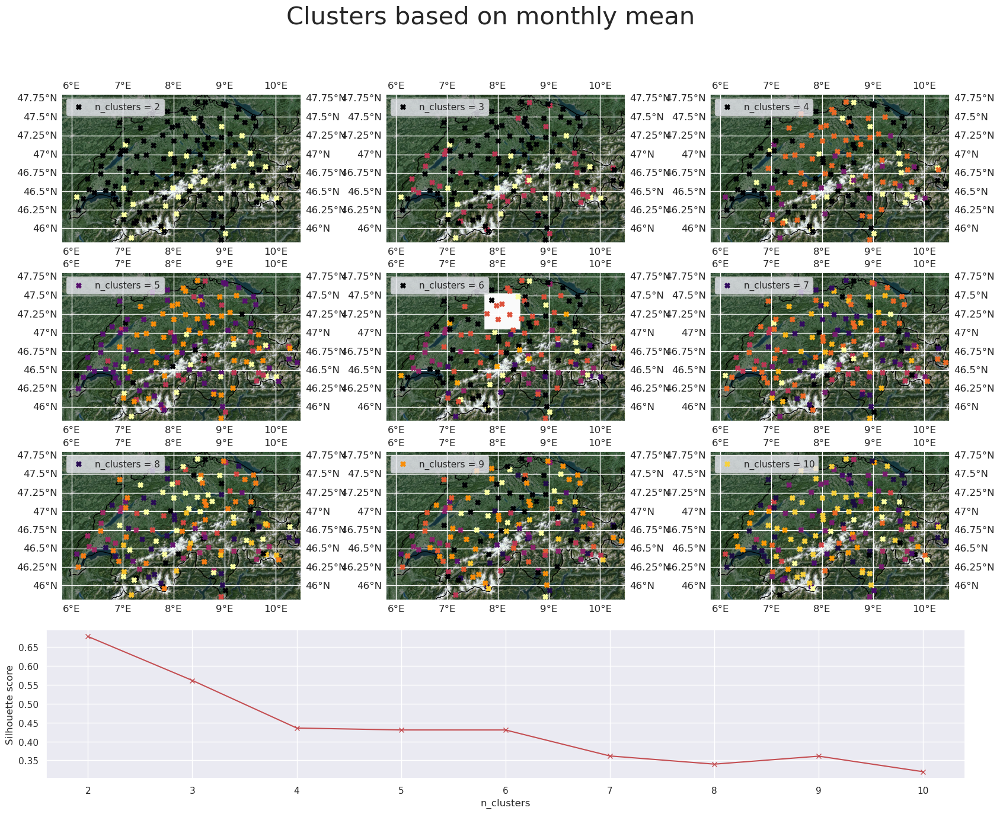

In [50]:
statistics = [
    ("mean4", lambda x : x.where(x.time.dt.month == 4).mean(dim = "time")),
    ("mean5", lambda x : x.where(x.time.dt.month == 5).mean(dim = "time")),
    ("mean6", lambda x : x.where(x.time.dt.month == 6).mean(dim = "time")),
    ("mean7", lambda x : x.where(x.time.dt.month == 7).mean(dim = "time")),
    ("mean8", lambda x : x.where(x.time.dt.month == 8).mean(dim = "time")),
    ("mean9", lambda x : x.where(x.time.dt.month == 9).mean(dim = "time")),
    ("mean10", lambda x : x.where(x.time.dt.month == 10).mean(dim = "time"))
    ]

sil = [0.]*9
n_clusters = list(np.arange(2,11))
labels = [None]*9


for i in range(3):
    for j in range(3):
        result, sil[i*3+j] = KMeansStationClustering(wg, statistics, n_clusters = 2 +i*3 + j)
        labels[i*3+j] = result.label

title = "monthly mean"
smntb.plotStations(result.longitude, result.latitude, labels = labels, title = f"Clusters based on " + title, clusters = n_clusters, silhouette_score = sil)

silh[title] = sil
print();

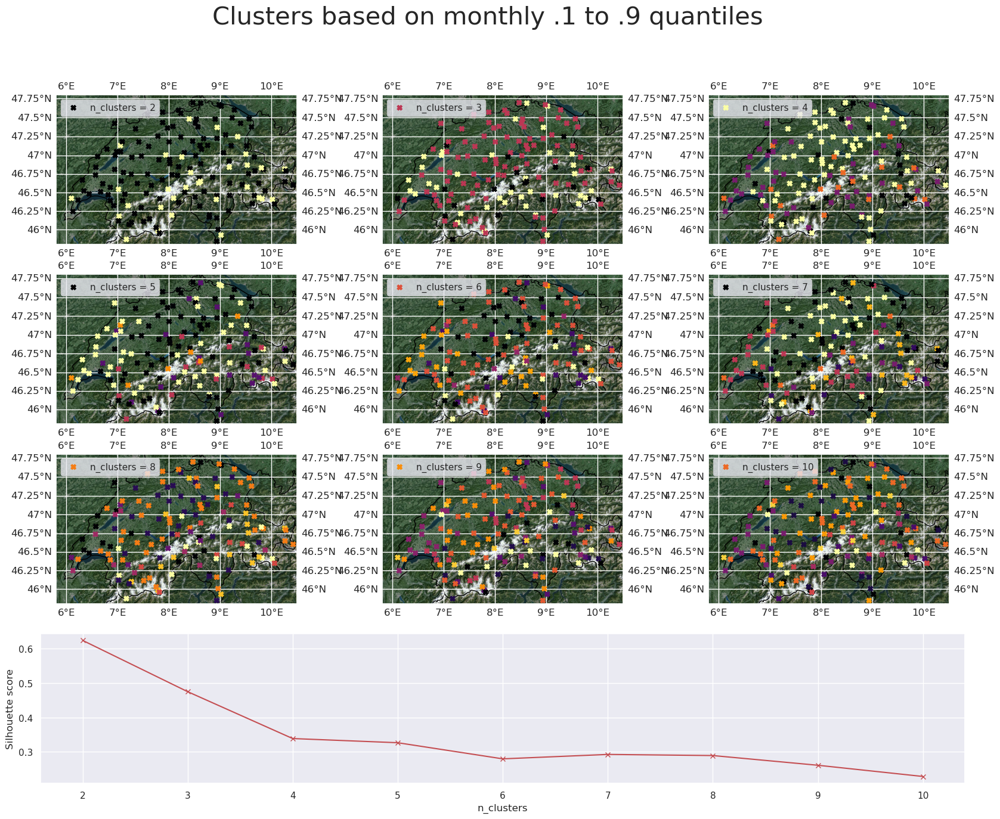

In [51]:

statistics = [
    ("quantile1-4", lambda x : x.where(x.time.dt.month == 4).quantile(0.1, dim = "time").drop_vars("quantile")),
    ("quantile2-4", lambda x : x.where(x.time.dt.month == 4).quantile(0.2, dim = "time").drop_vars("quantile")),
    ("quantile3-4", lambda x : x.where(x.time.dt.month == 4).quantile(0.3, dim = "time").drop_vars("quantile")),
    ("quantile4-4", lambda x : x.where(x.time.dt.month == 4).quantile(0.4, dim = "time").drop_vars("quantile")),
    ("quantile5-4", lambda x : x.where(x.time.dt.month == 4).quantile(0.5, dim = "time").drop_vars("quantile")),
    ("quantile6-4", lambda x : x.where(x.time.dt.month == 4).quantile(0.6, dim = "time").drop_vars("quantile")),
    ("quantile7-4", lambda x : x.where(x.time.dt.month == 4).quantile(0.7, dim = "time").drop_vars("quantile")),
    ("quantile8-4", lambda x : x.where(x.time.dt.month == 4).quantile(0.8, dim = "time").drop_vars("quantile")),
    ("quantile9-4", lambda x : x.where(x.time.dt.month == 4).quantile(0.9, dim = "time").drop_vars("quantile")),
    ("quantile1-5", lambda x : x.where(x.time.dt.month == 5).quantile(0.1, dim = "time").drop_vars("quantile")),
    ("quantile2-5", lambda x : x.where(x.time.dt.month == 5).quantile(0.2, dim = "time").drop_vars("quantile")),
    ("quantile3-5", lambda x : x.where(x.time.dt.month == 5).quantile(0.3, dim = "time").drop_vars("quantile")),
    ("quantile4-5", lambda x : x.where(x.time.dt.month == 5).quantile(0.4, dim = "time").drop_vars("quantile")),
    ("quantile5-5", lambda x : x.where(x.time.dt.month == 5).quantile(0.5, dim = "time").drop_vars("quantile")),
    ("quantile6-5", lambda x : x.where(x.time.dt.month == 5).quantile(0.6, dim = "time").drop_vars("quantile")),
    ("quantile7-5", lambda x : x.where(x.time.dt.month == 5).quantile(0.7, dim = "time").drop_vars("quantile")),
    ("quantile8-5", lambda x : x.where(x.time.dt.month == 5).quantile(0.8, dim = "time").drop_vars("quantile")),
    ("quantile9-5", lambda x : x.where(x.time.dt.month == 5).quantile(0.9, dim = "time").drop_vars("quantile")),
    ("quantile1-6", lambda x : x.where(x.time.dt.month == 6).quantile(0.1, dim = "time").drop_vars("quantile")),
    ("quantile2-6", lambda x : x.where(x.time.dt.month == 6).quantile(0.2, dim = "time").drop_vars("quantile")),
    ("quantile3-6", lambda x : x.where(x.time.dt.month == 6).quantile(0.3, dim = "time").drop_vars("quantile")),
    ("quantile4-6", lambda x : x.where(x.time.dt.month == 6).quantile(0.4, dim = "time").drop_vars("quantile")),
    ("quantile5-6", lambda x : x.where(x.time.dt.month == 6).quantile(0.5, dim = "time").drop_vars("quantile")),
    ("quantile6-6", lambda x : x.where(x.time.dt.month == 6).quantile(0.6, dim = "time").drop_vars("quantile")),
    ("quantile7-6", lambda x : x.where(x.time.dt.month == 6).quantile(0.7, dim = "time").drop_vars("quantile")),
    ("quantile8-6", lambda x : x.where(x.time.dt.month == 6).quantile(0.8, dim = "time").drop_vars("quantile")),
    ("quantile9-6", lambda x : x.where(x.time.dt.month == 6).quantile(0.9, dim = "time").drop_vars("quantile")),
    ("quantile1-7", lambda x : x.where(x.time.dt.month == 7).quantile(0.1, dim = "time").drop_vars("quantile")),
    ("quantile2-7", lambda x : x.where(x.time.dt.month == 7).quantile(0.2, dim = "time").drop_vars("quantile")),
    ("quantile3-7", lambda x : x.where(x.time.dt.month == 7).quantile(0.3, dim = "time").drop_vars("quantile")),
    ("quantile4-7", lambda x : x.where(x.time.dt.month == 7).quantile(0.4, dim = "time").drop_vars("quantile")),
    ("quantile5-7", lambda x : x.where(x.time.dt.month == 7).quantile(0.5, dim = "time").drop_vars("quantile")),
    ("quantile6-7", lambda x : x.where(x.time.dt.month == 7).quantile(0.6, dim = "time").drop_vars("quantile")),
    ("quantile7-7", lambda x : x.where(x.time.dt.month == 7).quantile(0.7, dim = "time").drop_vars("quantile")),
    ("quantile8-7", lambda x : x.where(x.time.dt.month == 7).quantile(0.8, dim = "time").drop_vars("quantile")),
    ("quantile9-7", lambda x : x.where(x.time.dt.month == 7).quantile(0.9, dim = "time").drop_vars("quantile")),
    ("quantile1-8", lambda x : x.where(x.time.dt.month == 8).quantile(0.1, dim = "time").drop_vars("quantile")),
    ("quantile2-8", lambda x : x.where(x.time.dt.month == 8).quantile(0.2, dim = "time").drop_vars("quantile")),
    ("quantile3-8", lambda x : x.where(x.time.dt.month == 8).quantile(0.3, dim = "time").drop_vars("quantile")),
    ("quantile4-8", lambda x : x.where(x.time.dt.month == 8).quantile(0.4, dim = "time").drop_vars("quantile")),
    ("quantile5-8", lambda x : x.where(x.time.dt.month == 8).quantile(0.5, dim = "time").drop_vars("quantile")),
    ("quantile6-8", lambda x : x.where(x.time.dt.month == 8).quantile(0.6, dim = "time").drop_vars("quantile")),
    ("quantile7-8", lambda x : x.where(x.time.dt.month == 8).quantile(0.7, dim = "time").drop_vars("quantile")),
    ("quantile8-8", lambda x : x.where(x.time.dt.month == 8).quantile(0.8, dim = "time").drop_vars("quantile")),
    ("quantile9-8", lambda x : x.where(x.time.dt.month == 8).quantile(0.9, dim = "time").drop_vars("quantile")),
    ("quantile1-9", lambda x : x.where(x.time.dt.month == 9).quantile(0.1, dim = "time").drop_vars("quantile")),
    ("quantile2-9", lambda x : x.where(x.time.dt.month == 9).quantile(0.2, dim = "time").drop_vars("quantile")),
    ("quantile3-9", lambda x : x.where(x.time.dt.month == 9).quantile(0.3, dim = "time").drop_vars("quantile")),
    ("quantile4-9", lambda x : x.where(x.time.dt.month == 9).quantile(0.4, dim = "time").drop_vars("quantile")),
    ("quantile5-9", lambda x : x.where(x.time.dt.month == 9).quantile(0.5, dim = "time").drop_vars("quantile")),
    ("quantile6-9", lambda x : x.where(x.time.dt.month == 9).quantile(0.6, dim = "time").drop_vars("quantile")),
    ("quantile7-9", lambda x : x.where(x.time.dt.month == 9).quantile(0.7, dim = "time").drop_vars("quantile")),
    ("quantile8-9", lambda x : x.where(x.time.dt.month == 9).quantile(0.8, dim = "time").drop_vars("quantile")),
    ("quantile9-9", lambda x : x.where(x.time.dt.month == 9).quantile(0.9, dim = "time").drop_vars("quantile")),
    ("quantile1-10", lambda x : x.where(x.time.dt.month == 10).quantile(0.1, dim = "time").drop_vars("quantile")),
    ("quantile2-10", lambda x : x.where(x.time.dt.month == 10).quantile(0.2, dim = "time").drop_vars("quantile")),
    ("quantile3-10", lambda x : x.where(x.time.dt.month == 10).quantile(0.3, dim = "time").drop_vars("quantile")),
    ("quantile4-10", lambda x : x.where(x.time.dt.month == 10).quantile(0.4, dim = "time").drop_vars("quantile")),
    ("quantile5-10", lambda x : x.where(x.time.dt.month == 10).quantile(0.5, dim = "time").drop_vars("quantile")),
    ("quantile6-10", lambda x : x.where(x.time.dt.month == 10).quantile(0.6, dim = "time").drop_vars("quantile")),
    ("quantile7-10", lambda x : x.where(x.time.dt.month == 10).quantile(0.7, dim = "time").drop_vars("quantile")),
    ("quantile8-10", lambda x : x.where(x.time.dt.month == 10).quantile(0.8, dim = "time").drop_vars("quantile")),
    ("quantile9-10", lambda x : x.where(x.time.dt.month == 10).quantile(0.9, dim = "time").drop_vars("quantile"))
    
    ]
sil = [0.]*9
n_clusters = list(np.arange(2,11))
labels = [None]*9


for i in range(3):
    for j in range(3):
        result, sil[i*3+j] = KMeansStationClustering(wg, statistics, n_clusters = 2 +i*3 + j)
        labels[i*3+j] = result.label

title = "monthly .1 to .9 quantiles"
smntb.plotStations(result.longitude, result.latitude, labels = labels, title = f"Clusters based on " + title, clusters = n_clusters, silhouette_score = sil)

silh[title] = sil
print();

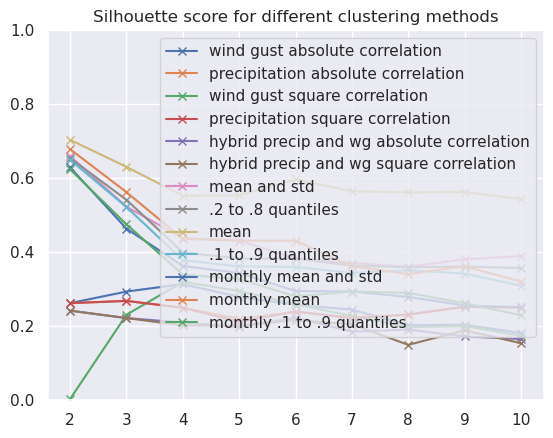

In [52]:
for key in silh.keys():
    plt.plot(n_clusters, silh[key], label = key, marker = 'x')
plt.legend()
plt.ylim(0.,1.)
plt.title("Silhouette score for different clustering methods")
#plt.savefig("/work/FAC/FGSE/IDYST/tbeucler/downscaling/alecler1/plots/SwissMetNet/Clustering/silhouette_score.png", bbox_inches = 'tight')
plt.show()
print();

These different plots tend to show very disappointing behaviours:
- the clusters of stations do not exhibit geographic coherence
- they do not exhibit topographic coherence either (there are not a group for lowlands and another one for mountains, nor are there groups southly exposed and others northly exposed

But what we have done does not reflect the spatial correlation between stations : to do that, let's consider the actual correlation between variables.

### 3.b. Spectral clustering of stations based on time correlation between stations

Finding clusters for n = 2...
Finding clusters for n = 3...
Finding clusters for n = 4...
Finding clusters for n = 5...
Finding clusters for n = 6...
Finding clusters for n = 7...
Finding clusters for n = 8...
Finding clusters for n = 9...
Finding clusters for n = 10...


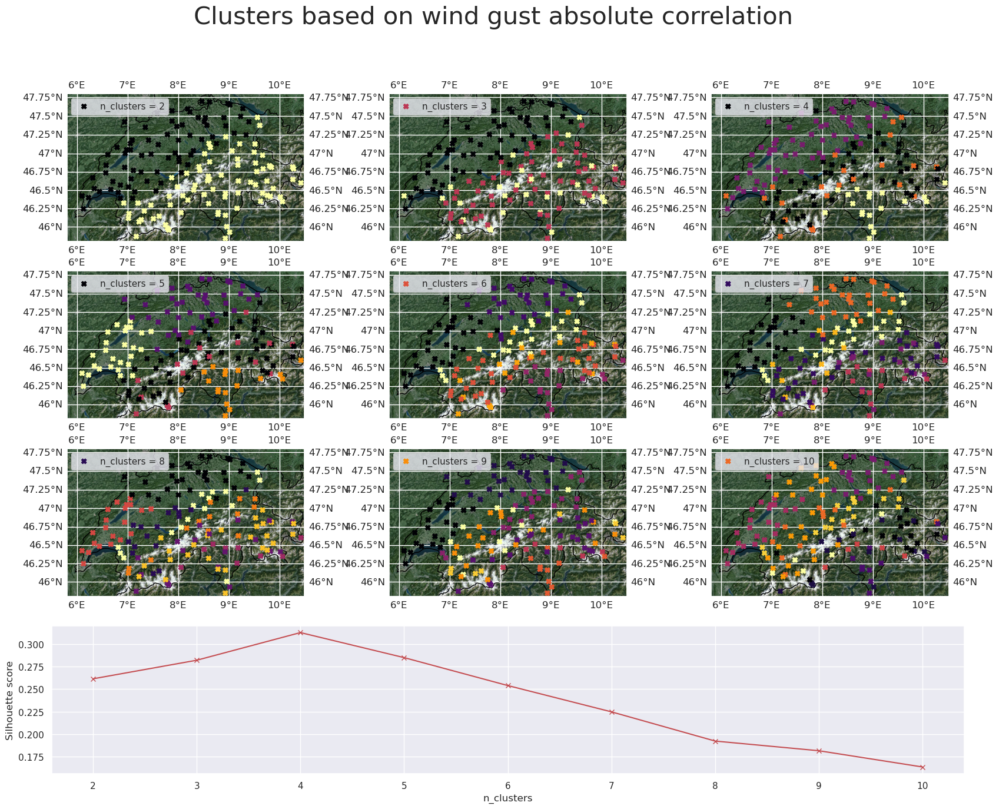

In [53]:
sil = [0.]*9
n_clusters = list(np.arange(2,11))
labels = [None]*9


for i in range(3):
    for j in range(3):
        print(f"Finding clusters for n = {2+i*3+j}...")
        result, sil[i*3+j] = SpectralStationClustering(wg, n_clusters = 2 +i*3 + j, affinities = affwg, method = "abs", n_init = 50)
        labels[i*3+j] = result.label

title = "wind gust absolute correlation"
smntb.plotStations(result.longitude, result.latitude, labels = labels, title = f"Clusters based on " + title, clusters = n_clusters, silhouette_score = sil, toFile = "/work/FAC/FGSE/IDYST/tbeucler/downscaling/alecler1/plots/SwissMetNet/Clustering/CorrelationClustering.png", show = True)

silh[title] = sil
print();

Finding clusters for n = 2...
Finding clusters for n = 3...
Finding clusters for n = 4...
Finding clusters for n = 5...
Finding clusters for n = 6...
Finding clusters for n = 7...
Finding clusters for n = 8...
Finding clusters for n = 9...
Finding clusters for n = 10...


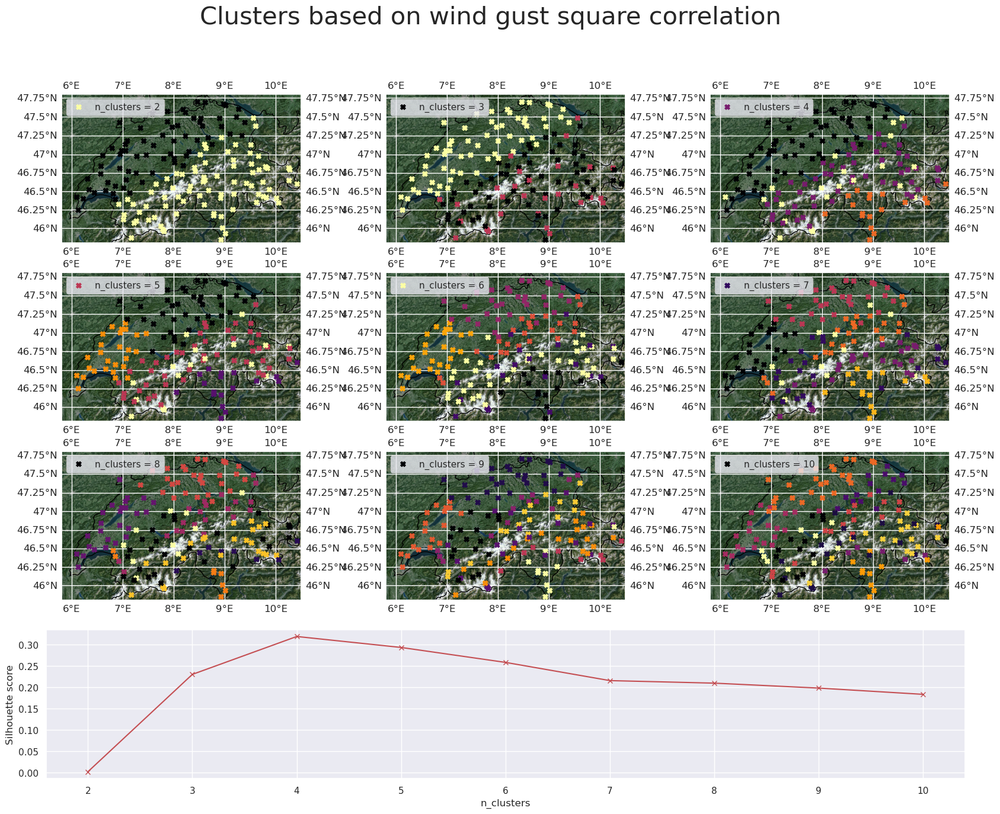

In [55]:
sil = [0.]*9
n_clusters = list(np.arange(2,11))
labels = [None]*9


for i in range(3):
    for j in range(3):
        print(f"Finding clusters for n = {2+i*3+j}...")
        result, sil[i*3+j] = SpectralStationClustering(wg, n_clusters = 2 +i*3 + j, affinities = affwg, method = "square", n_init = 50)
        labels[i*3+j] = result.label

title = "wind gust square correlation"
smntb.plotStations(result.longitude, result.latitude, labels = labels, title = f"Clusters based on " + title, clusters = n_clusters, silhouette_score = sil, toFile = "/work/FAC/FGSE/IDYST/tbeucler/downscaling/alecler1/plots/SwissMetNet/Clustering/CorrelationClustering.png", show = True)

silh[title] = sil
print();

Finding clusters for n = 2...
Finding clusters for n = 3...
Finding clusters for n = 4...
Finding clusters for n = 5...
Finding clusters for n = 6...
Finding clusters for n = 7...
Finding clusters for n = 8...
Finding clusters for n = 9...
Finding clusters for n = 10...


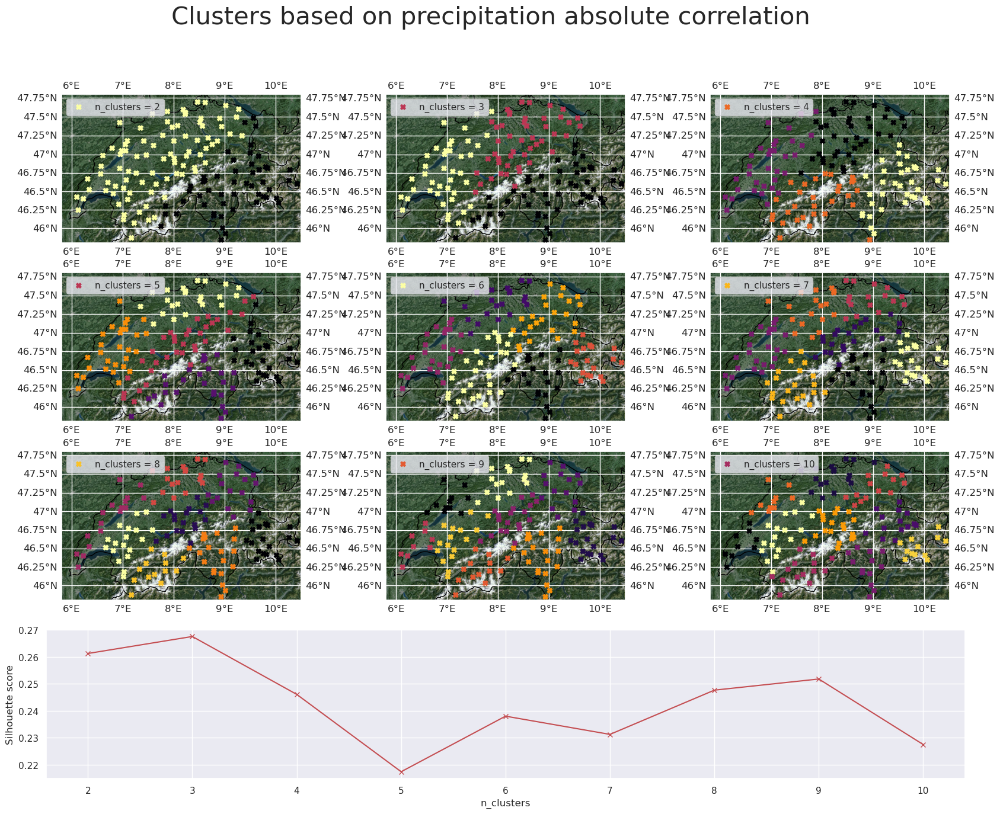

In [56]:
sil = [0.]*9
n_clusters = list(np.arange(2,11))
labels = [None]*9


for i in range(3):
    for j in range(3):
        print(f"Finding clusters for n = {2+i*3+j}...")
        result, sil[i*3+j] = SpectralStationClustering(precip, n_clusters = 2 +i*3 + j, affinities = affprecip, method = "abs", n_init = 50)
        labels[i*3+j] = result.label

title = "precipitation absolute correlation"
smntb.plotStations(result.longitude, result.latitude, labels = labels, title = f"Clusters based on " + title, clusters = n_clusters, silhouette_score = sil, toFile = "/work/FAC/FGSE/IDYST/tbeucler/downscaling/alecler1/plots/SwissMetNet/Clustering/CorrelationClustering.png", show = True)

silh[title] = sil
print();

Finding clusters for n = 2...
Finding clusters for n = 3...
Finding clusters for n = 4...
Finding clusters for n = 5...
Finding clusters for n = 6...
Finding clusters for n = 7...
Finding clusters for n = 8...
Finding clusters for n = 9...
Finding clusters for n = 10...


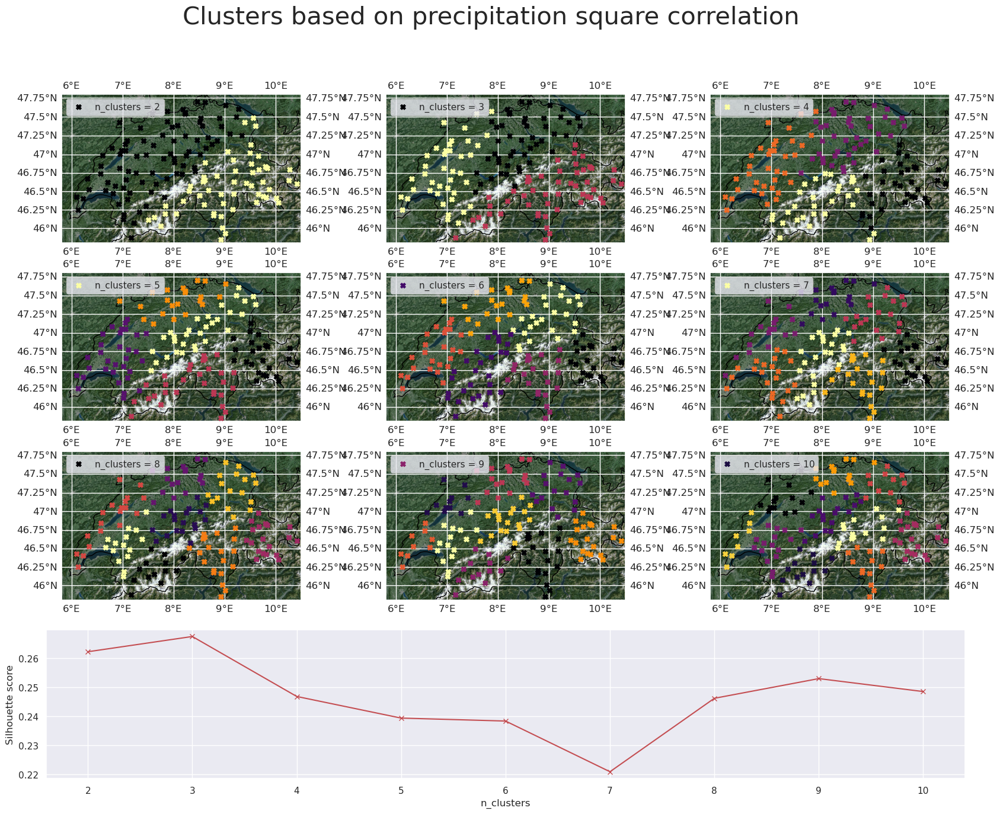

In [57]:
sil = [0.]*9
n_clusters = list(np.arange(2,11))
labels = [None]*9


for i in range(3):
    for j in range(3):
        print(f"Finding clusters for n = {2+i*3+j}...")
        result, sil[i*3+j] = SpectralStationClustering(precip, n_clusters = 2 +i*3 + j, affinities = affprecip, method = "square", n_init = 50)
        labels[i*3+j] = result.label

title = "precipitation square correlation"
smntb.plotStations(result.longitude, result.latitude, labels = labels, title = f"Clusters based on " + title, clusters = n_clusters, silhouette_score = sil, toFile = "/work/FAC/FGSE/IDYST/tbeucler/downscaling/alecler1/plots/SwissMetNet/Clustering/CorrelationClustering.png", show = True)

silh[title] = sil
print();

Finding clusters for n = 2...
Finding clusters for n = 3...
Finding clusters for n = 4...
Finding clusters for n = 5...
Finding clusters for n = 6...
Finding clusters for n = 7...
Finding clusters for n = 8...
Finding clusters for n = 9...
Finding clusters for n = 10...


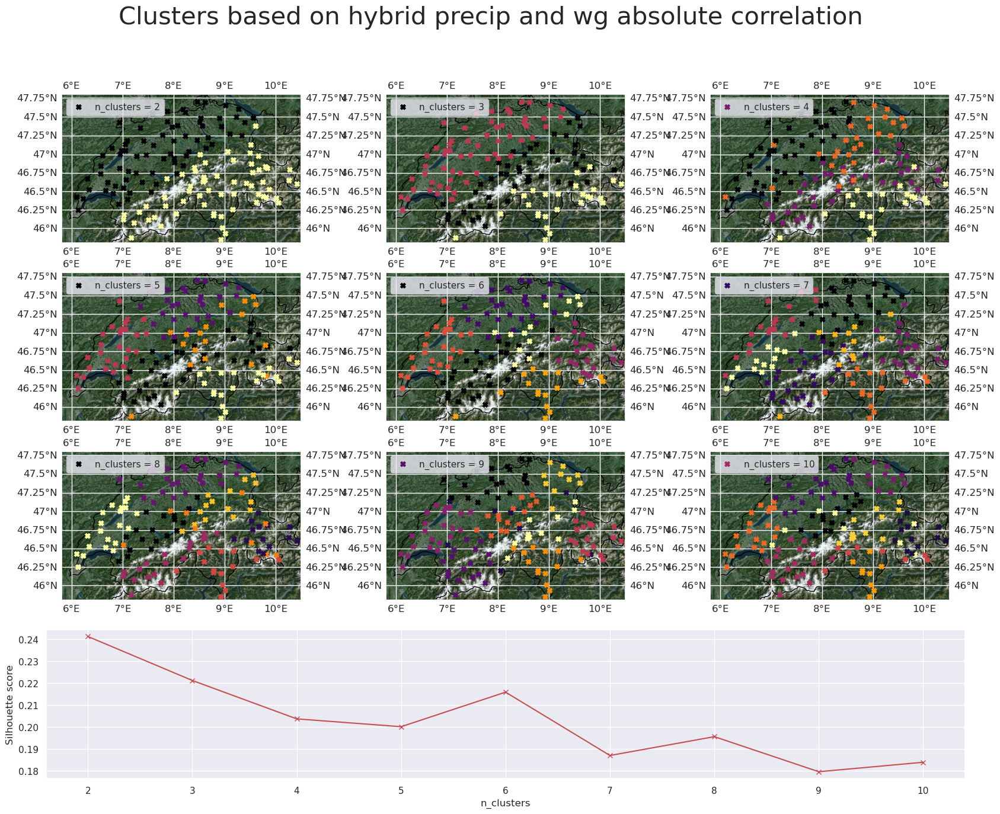

In [58]:
sil = [0.]*9
n_clusters = list(np.arange(2,11))
labels = [None]*9


for i in range(3):
    for j in range(3):
        print(f"Finding clusters for n = {2+i*3+j}...")
        result, sil[i*3+j] = SpectralStationClustering(precip, n_clusters = 2 +i*3 + j, affinities = (affprecip+affwg)/2, method = "abs", n_init = 50)
        labels[i*3+j] = result.label

title = "hybrid precip and wg absolute correlation"
smntb.plotStations(result.longitude, result.latitude, labels = labels, title = f"Clusters based on " + title, clusters = n_clusters, silhouette_score = sil, toFile = "/work/FAC/FGSE/IDYST/tbeucler/downscaling/alecler1/plots/SwissMetNet/Clustering/CorrelationClustering.png", show = True)

silh[title] = sil
print();

Finding clusters for n = 2...
Finding clusters for n = 3...
Finding clusters for n = 4...
Finding clusters for n = 5...
Finding clusters for n = 6...
Finding clusters for n = 7...
Finding clusters for n = 8...
Finding clusters for n = 9...
Finding clusters for n = 10...


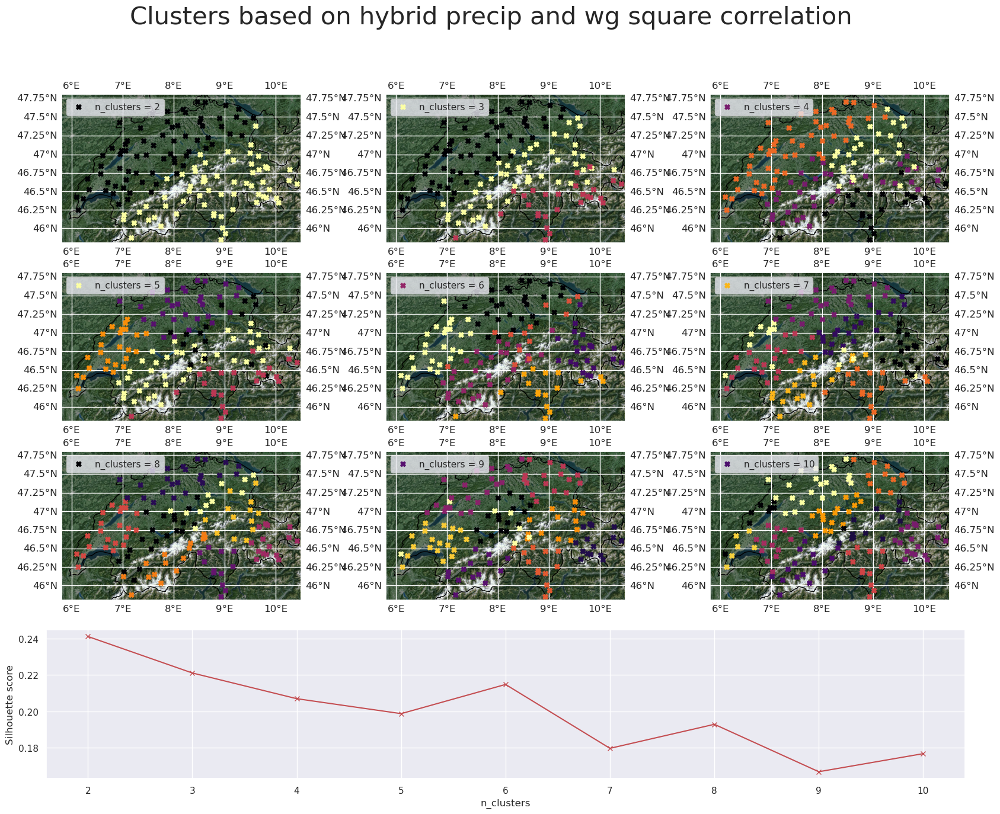

In [59]:
sil = [0.]*9
n_clusters = list(np.arange(2,11))
labels = [None]*9


for i in range(3):
    for j in range(3):
        print(f"Finding clusters for n = {2+i*3+j}...")
        result, sil[i*3+j] = SpectralStationClustering(precip, n_clusters = 2 +i*3 + j, affinities = (affprecip+affwg)/2, method = "abs", n_init = 50)
        labels[i*3+j] = result.label

title = "hybrid precip and wg square correlation"
smntb.plotStations(result.longitude, result.latitude, labels = labels, title = f"Clusters based on " + title, clusters = n_clusters, silhouette_score = sil, toFile = "/work/FAC/FGSE/IDYST/tbeucler/downscaling/alecler1/plots/SwissMetNet/Clustering/CorrelationClustering.png", show = True)

silh[title] = sil
print();

### 3.c. Purely spatial correlation

It is interesting to test our precipitation-based clustering against a distance-based one, as precipitation can be very local phenomenon.

In [67]:
inverseDistances = np.clip(np.array([[np.exp(-((wg.isel(station=i).longitude.values - wg.isel(station=j).longitude.values)**2 + (wg.isel(station=i).latitude.values - wg.isel(station=j).latitude.values)**2)) for i in range(nb_of_stations)] for j in range(nb_of_stations)]), 0., None)

In [68]:
inverseDistances

array([[1.00000000e+00, 2.21269691e-01, 6.48564383e-01, ...,
        5.76294875e-03, 5.30866342e-01, 7.78139084e-01],
       [2.21269691e-01, 1.00000000e+00, 3.05893001e-02, ...,
        2.17445942e-01, 5.02237582e-01, 1.41739984e-01],
       [6.48564383e-01, 3.05893001e-02, 1.00000000e+00, ...,
        1.91244088e-04, 2.00698198e-01, 4.60985818e-01],
       ...,
       [5.76294875e-03, 2.17445942e-01, 1.91244088e-04, ...,
        1.00000000e+00, 1.42009701e-02, 7.70926829e-03],
       [5.30866342e-01, 5.02237582e-01, 2.00698198e-01, ...,
        1.42009701e-02, 1.00000000e+00, 2.22172538e-01],
       [7.78139084e-01, 1.41739984e-01, 4.60985818e-01, ...,
        7.70926829e-03, 2.22172538e-01, 1.00000000e+00]])

Finding clusters for n = 2...
Finding clusters for n = 3...
Finding clusters for n = 4...
Finding clusters for n = 5...
Finding clusters for n = 6...
Finding clusters for n = 7...
Finding clusters for n = 8...
Finding clusters for n = 9...
Finding clusters for n = 10...


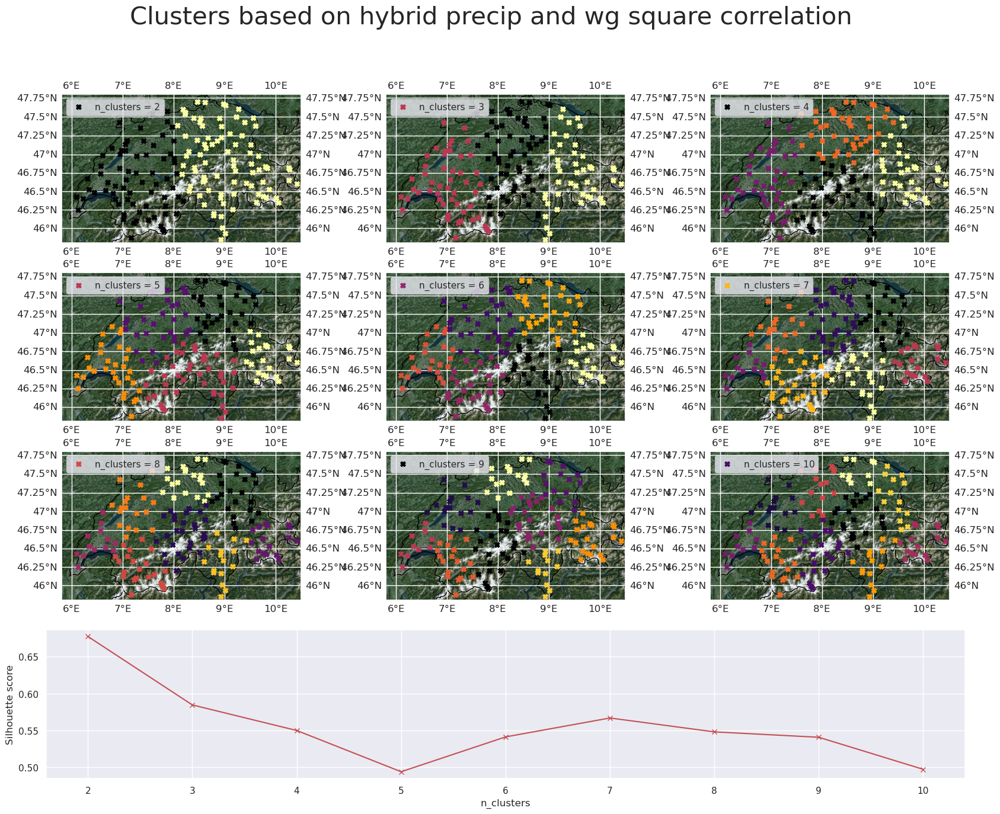

In [69]:
sil = [0.]*9
n_clusters = list(np.arange(2,11))
labels = [None]*9


for i in range(3):
    for j in range(3):
        print(f"Finding clusters for n = {2+i*3+j}...")
        result, sil[i*3+j] = SpectralStationClustering(precip, n_clusters = 2 +i*3 + j, affinities = inverseDistances, method = "abs", n_init = 50)
        labels[i*3+j] = result.label

title = "hybrid precip and wg square correlation"
smntb.plotStations(result.longitude, result.latitude, labels = labels, title = f"Clusters based on " + title, clusters = n_clusters, silhouette_score = sil, toFile = "/work/FAC/FGSE/IDYST/tbeucler/downscaling/alecler1/plots/SwissMetNet/Clustering/CorrelationClustering.png", show = True)

silh[title] = sil
print();

### 1.d. With affinity progagation...

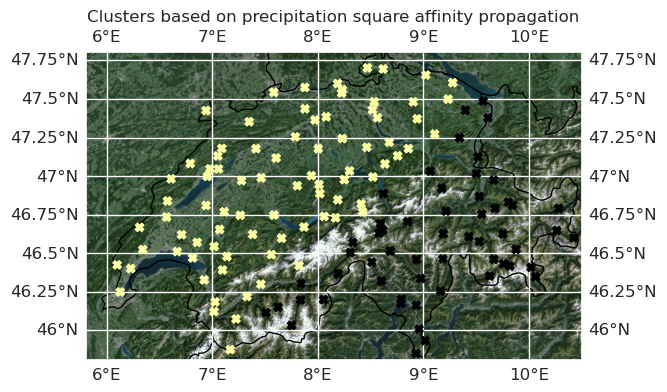

In [87]:
result, sil = SpectralStationClustering(precip, affinities = affprecip, method = "square")
labels = result.label

title = "precipitation square affinity propagation"
plotStations(result.longitude, result.latitude, labels = labels.values, markers = "X", title = f"Clusters based on " + title, toFile = "/work/FAC/FGSE/IDYST/tbeucler/downscaling/alecler1/plots/SwissMetNet/Clustering/AffinityPrecipClustering.png", show = True)

silh[title] = sil
print()

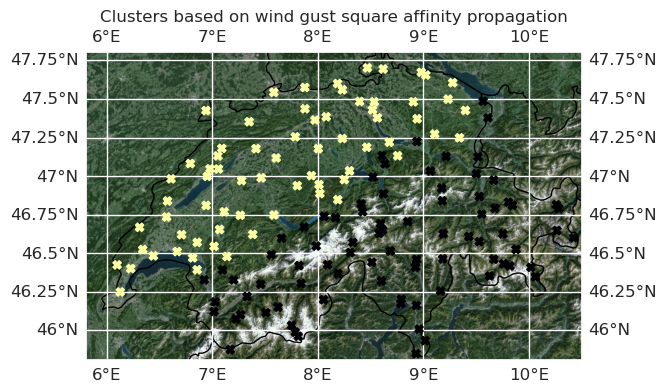

In [89]:
result, sil = SpectralStationClustering(precip, affinities = affwg, method = "square")
labels = result.label

title = "wind gust square affinity propagation"
plotStations(result.longitude, result.latitude, labels = labels.values, markers = "X", title = f"Clusters based on " + title, toFile = "/work/FAC/FGSE/IDYST/tbeucler/downscaling/alecler1/plots/SwissMetNet/Clustering/AffinityPrecipClustering.png", show = True)

silh[title] = sil
print()

### 1.e. With agglomeration...

Finding clusters for n = 2...
Finding clusters for n = 3...
Finding clusters for n = 4...
Finding clusters for n = 5...
Finding clusters for n = 6...
Finding clusters for n = 7...
Finding clusters for n = 8...
Finding clusters for n = 9...
Finding clusters for n = 10...


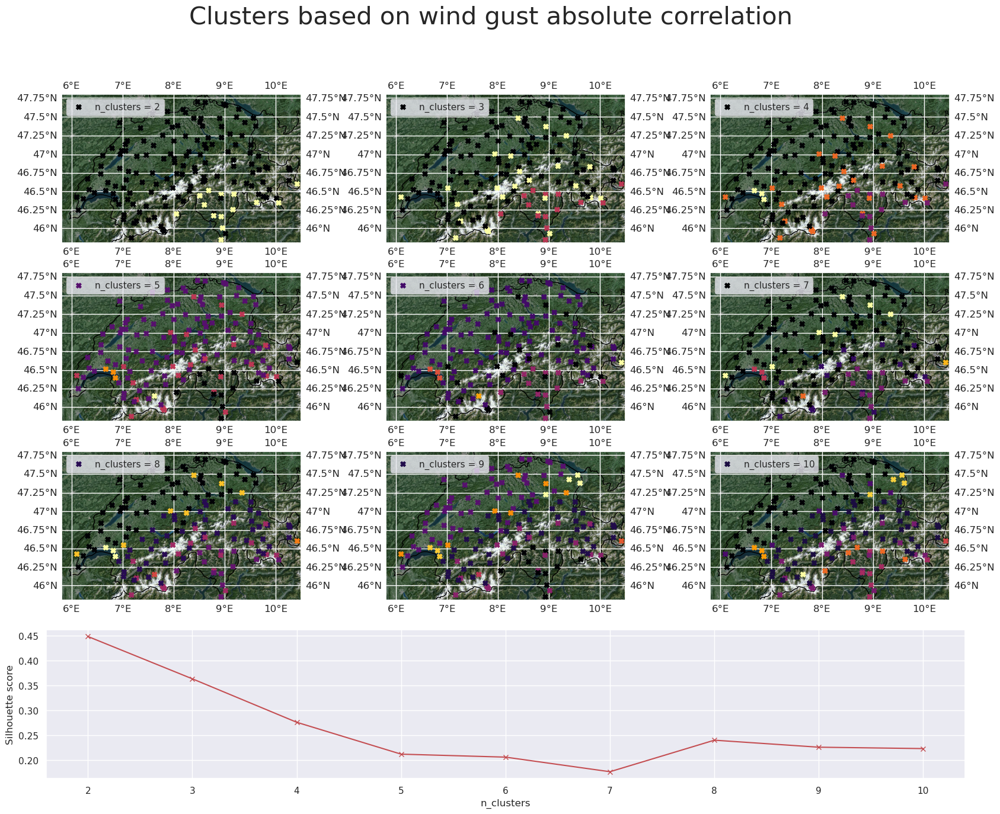

In [104]:
# To modify

sil = [0.]*9
n_clusters = list(np.arange(2,11))
labels = [None]*9

nans = np.isnan(np.diag(affwg))
aff = affwg[~nans][:,~nans]
np.nan_to_num(aff, copy = False, nan=0.)

distwg = np.clip(-np.log(aff), a_min = 0, a_max = 1e8)
np.nan_to_num(distwg, copy = False, nan=1e8)

work = xr.Dataset(
    data_vars = {"affinity":(["station", "station"], distwg)},
    coords = {"station":("station",wg.station.values[~nans]),
              "longitude":("station",wg.longitude.values[~nans]),
              "latitude":("station",wg.latitude.values[~nans])
              }
)

for i in range(3):
    for j in range(3):
        print(f"Finding clusters for n = {2+i*3+j}...")
        result, sil[i*3+j] = AgglomerativeStationClustering(work, n_clusters = 2 +i*3 + j, affinities = distwg, method = "abs")
        labels[i*3+j] = result.label

title = "wind gust absolute correlation"
smntb.plotStations(result.longitude, result.latitude, labels = labels, title = f"Clusters based on " + title, clusters = n_clusters, silhouette_score = sil, show = True)

silh[title] = sil
print();

### Test cells

Finding clusters for n = 2...
Finding clusters for n = 3...
Finding clusters for n = 4...
Finding clusters for n = 5...
Finding clusters for n = 6...
Finding clusters for n = 7...
Finding clusters for n = 8...
Finding clusters for n = 9...
Finding clusters for n = 10...


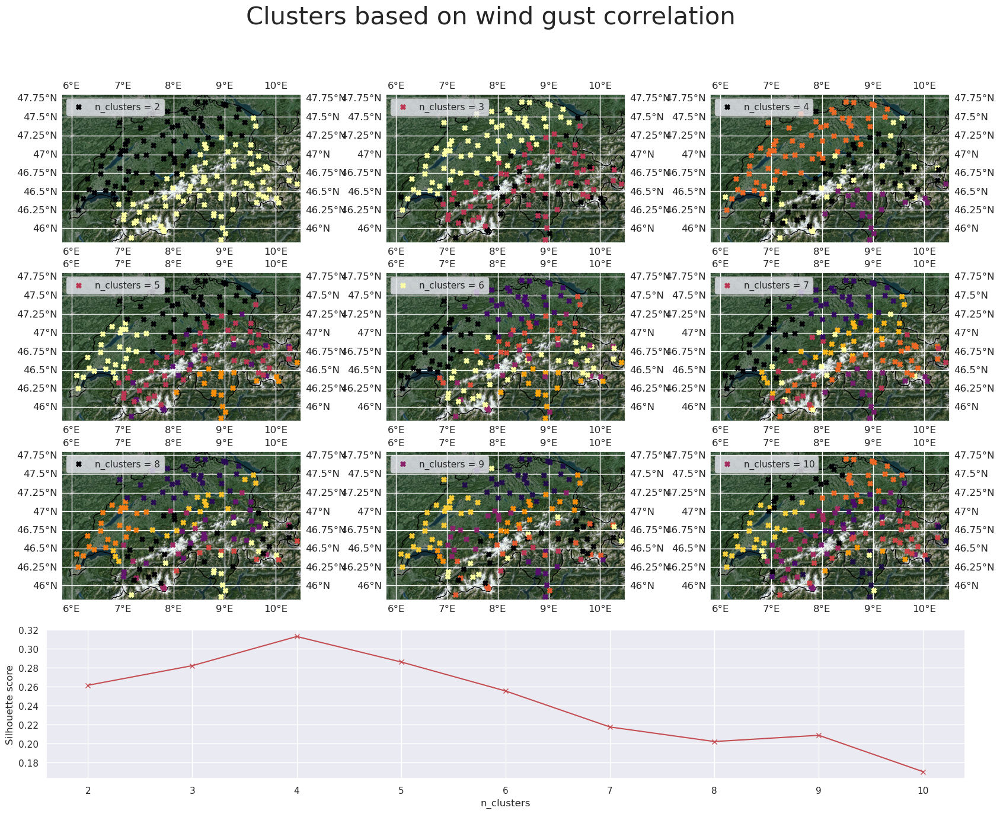

In [53]:
sil = [0.]*9
n_clusters = list(np.arange(2,11))
labels = [None]*9


for i in range(3):
    for j in range(3):
        print(f"Finding clusters for n = {2+i*3+j}...")
        result, sil[i*3+j] = LocalSpectralStationClustering(wg, n_clusters = 2 +i*3 + j, affinities = aff)
        labels[i*3+j] = result.label

title = "wind gust correlation"
smntb.plotStations(result.longitude, result.latitude, labels = labels, title = f"Clusters based on " + title, clusters = n_clusters, silhouette_score = sil, toFile = "/work/FAC/FGSE/IDYST/tbeucler/downscaling/alecler1/plots/SwissMetNet/Clustering/CorrelationClustering.png", show = True)

silh[title] = sil
print();

Finding clusters for n = 2...
Finding clusters for n = 3...
Finding clusters for n = 4...
Finding clusters for n = 5...
Finding clusters for n = 6...
Finding clusters for n = 7...
Finding clusters for n = 8...
Finding clusters for n = 9...
Finding clusters for n = 10...


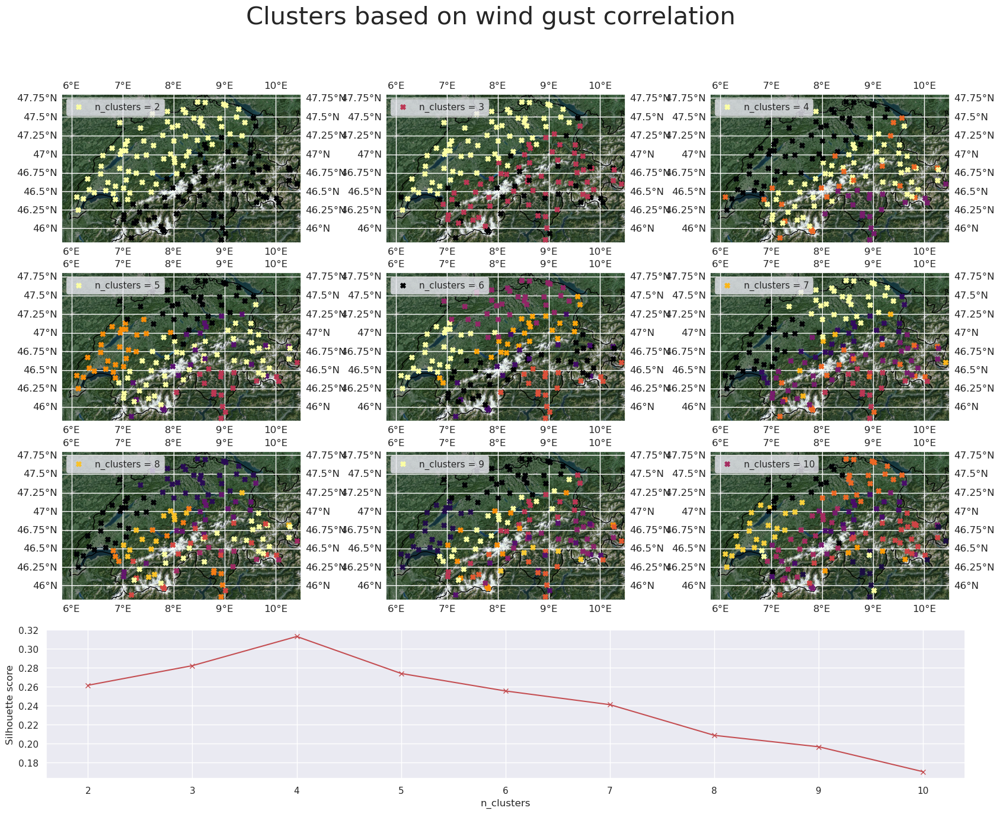

In [54]:
sil = [0.]*9
n_clusters = list(np.arange(2,11))
labels = [None]*9


for i in range(3):
    for j in range(3):
        print(f"Finding clusters for n = {2+i*3+j}...")
        result, sil[i*3+j] = LocalSpectralStationClustering(wg, n_clusters = 2 +i*3 + j, affinities = aff)
        labels[i*3+j] = result.label

title = "wind gust correlation"
smntb.plotStations(result.longitude, result.latitude, labels = labels, title = f"Clusters based on " + title, clusters = n_clusters, silhouette_score = sil, toFile = "/work/FAC/FGSE/IDYST/tbeucler/downscaling/alecler1/plots/SwissMetNet/Clustering/CorrelationClustering.png", show = True, method = "square")

silh[title] = sil
print();

In [29]:
nans = np.isnan(np.diag(affinities))
nansmatrix = nans.reshape((-1,1))@nans.reshape((1,-1))

In [32]:
aff[~nans][:,~nans]

array([[1.        , 0.56499484, 0.56891716, ..., 0.25570608, 0.53612798,
        0.58883517],
       [0.56499484, 1.        , 0.46594653, ..., 0.34276168, 0.46140997,
        0.43856535],
       [0.56891716, 0.46594653, 1.        , ..., 0.19822456, 0.42816321,
        0.50737237],
       ...,
       [0.25570608, 0.34276168, 0.19822456, ..., 1.        , 0.2276698 ,
        0.21102393],
       [0.53612798, 0.46140997, 0.42816321, ..., 0.2276698 , 1.        ,
        0.47325454],
       [0.58883517, 0.43856535, 0.50737237, ..., 0.21102393, 0.47325454,
        1.        ]])

In [31]:
nansmatrix

array([[False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       ...,
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False]])

In [22]:
affprecip

array([[1.        ,        nan, 0.19558222, ..., 0.13433517, 0.15217875,
        0.25050489],
       [       nan,        nan,        nan, ...,        nan,        nan,
               nan],
       [0.19558222,        nan, 1.        , ..., 0.09111487, 0.15017628,
        0.14344449],
       ...,
       [0.13433517,        nan, 0.09111487, ..., 1.        , 0.09376666,
        0.12566823],
       [0.15217875,        nan, 0.15017628, ..., 0.09376666, 1.        ,
        0.10029874],
       [0.25050489,        nan, 0.14344449, ..., 0.12566823, 0.10029874,
        1.        ]])

In [24]:
nans = np.isnan(np.diag(affprecip))

In [25]:
nans

array([False,  True, False, False, False, False, False, False,  True,
       False, False, False, False, False, False, False, False, False,
       False, False,  True, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
        True, False, False, False, False, False, False,  True, False,
       False, False,  True, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
        True, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False,  True, False,
       False, False,  True, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False,  True,
       False,  True, False, False, False,  True, False, False, False,
       False, False, False, False, False, False,  True, False, False,
        True, False, False, False, False, False, False, False, False,
       False, False,

In [26]:
nansmatrix = nans.reshape((-1,1))@nans.reshape((1,-1))

In [28]:
aff = affprecip[~nans][:,~nans]

In [29]:
aff

array([[1.        , 0.19558222, 0.19493635, ..., 0.13433517, 0.15217875,
        0.25050489],
       [0.19558222, 1.        , 0.1471759 , ..., 0.09111487, 0.15017628,
        0.14344449],
       [0.19493635, 0.1471759 , 1.        , ..., 0.23680367, 0.11908154,
        0.17580521],
       ...,
       [0.13433517, 0.09111487, 0.23680367, ..., 1.        , 0.09376666,
        0.12566823],
       [0.15217875, 0.15017628, 0.11908154, ..., 0.09376666, 1.        ,
        0.10029874],
       [0.25050489, 0.14344449, 0.17580521, ..., 0.12566823, 0.10029874,
        1.        ]])

In [30]:
np.isnan(aff).any()

True

In [85]:
def localStationClustering(data, **kwargs):
    """
    Cluster data based on correlation between station, aggregated over time, with Spectral Clustering algorithm.
    """
    stations = data.station.values
    nb_of_stations = len(stations)
    if "affinities" in kwargs.keys():
        affinities = kwargs.get("affinities")
    else:
        affinities = np.array([[xr.corr(data.isel(station=i), data.isel(station=j), dim = "time").values for i in range(nb_of_stations)] for j in range(nb_of_stations)])
    affinities = np.abs(affinities) if kwargs.get("method", "abs") == "abs" else affinities
    nans = np.isnan(np.diag(affinities))
    nansmatrix = nans.reshape((-1,1))@nans.reshape((1,-1))
    affinities = affinities[~nans][:,~nans]
    np.nan_to_num(affinities, copy = False, nan=0.)
    result = xr.Dataset(
        data_vars = {"affinity":(["station", "station"], affinities)},
        coords = {"station":("station",data.station.values[~nans]),
                  "longitude":("station",data.longitude.values[~nans]),
                  "latitude":("station",data.latitude.values[~nans])
                  }
    )
    clustering = SpectralClustering(n_clusters = kwargs.get("n_clusters", 2), assign_labels='discretize', affinity = 'precomputed').fit(affinities)
    result["label"] = xr.DataArray(clustering.labels_, coords = {"station":result.station}, dims = ["station"])
    distances = np.clip(-np.log(affinities), a_min = 0, a_max = 1e8)
    np.nan_to_num(distances, copy = False, nan=1e8)
    return result, metrics.silhouette_score(distances, clustering.labels_, metric='precomputed')

In [75]:
labels.values

array([0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0,
       0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0,
       0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1,
       1, 0, 1, 0, 1, 0, 1])

In [81]:
print("x")

x
